In this notebook we aim to investigate **apparent value** through data attribute extraction methods. We perform multiple statistical and ML analyses on the extracted attributes.

In [189]:
import time

import numpy as np
import polars as pl
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler
from sklearn.decomposition import PCA


### **Load** data

In [190]:
columns_ordered = pl.read_csv('./run_50_100/901-1000.csv').columns
column_order_query = [pl.col(col_name) for col_name in columns_ordered]

Load extracted attributes

In [191]:
df_50_100 = pl.concat(
    [
        pl.read_csv('./run_50_100/0-100.csv')
            .rename({'n_unkown_features': 'n_unknown_features'})
            .with_columns(pl.lit(-1, dtype=pl.Int64).alias('num_sample_files'))
            .select(column_order_query),
        pl.read_csv('./run_50_100/101-300.csv')
            .with_columns(pl.lit(-1, dtype=pl.Int64).alias('num_sample_files'))
            .select(column_order_query),
        pl.read_csv('./run_50_100/301-600.csv'),
        pl.read_csv('./run_50_100/701-800.csv'),
        pl.read_csv('./run_50_100/901-1000.csv'),
    ]
)
df_50_100

n_int_features,n_float_features,n_string_features,n_datetime_features,n_unknown_features,n_categorical_features,n_noncateg_features,is_datetime_consistent,n_ordered_features,file_type,is_file_structured,is_file_semi_structured,is_file_unstructured,encoding,has_duplicated_rows,has_null_rows,has_null_feature_values,n_features,n_rows,n_rows_times_features,avg_ratio_duplication_noncateg_features,avg_ratio_duplication_categ_features,ratio_features_at_least_one_null,avg_ratio_null_values_features,avg_variance_numerical_features,avg_skewness_numerical_features,avg_kurtosis_numerical_features,avg_median_dev_numerical_features,avg_n_outliers_numerical_features,avg_unalikeability_categ_features,avg_margin_error_numerical_features,avg_gini_impurity_categ_features,time_diff_current_and_last_update,num_pii_entities,profiler_sample_size,num_sample_files,ref_no_slash
i64,i64,i64,i64,i64,i64,i64,i64,i64,str,i64,i64,i64,str,i64,i64,i64,i64,i64,i64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,i64,f64,i64,i64,str
21,13,0,0,0,18,16,1,2,"""csv""",1,0,0,"""utf-8""",0,0,0,34,34,1156,0.574189,0.04279,0.0,0.0,0.058245,0.219852,1.287968,0.071417,0.382353,0.590193,0.025944,0.589889,0,49.436,1941,-1,"""uciml_faulty-s..."
3,0,0,1,0,2,2,1,1,"""csv""",1,0,0,"""utf-8""",0,0,0,4,4,16,0.651621,0.001507,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.844951,0.0,0.844933,0,0.0,48120,-1,"""fedesoriano_tr..."
3,0,0,0,0,7,1,1,0,"""csv""",1,0,0,"""utf-8""",1,0,0,8,8,64,0.343548,0.041376,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.640801,0.0,0.640653,0,4.776,4340,-1,"""akshaydattatra..."
3,0,0,1,0,10,1,1,1,"""csv""",1,0,0,"""utf-8""",0,0,1,11,11,121,1.0,0.004659,0.180053,4.347107,0.0,0.0,0.0,0.0,0.0,0.666259,0.0,0.666,0,0.0,2627,-1,"""kaushiksuresh1..."
4,0,0,0,0,10,1,1,0,"""csv""",1,0,0,"""utf-8""",0,0,1,11,11,121,1.0,0.001517,0.173897,13.07438,0.0,0.0,0.0,0.0,0.0,0.666694,0.0,0.666609,0,0.0,8068,-1,"""kaushiksuresh1..."
2,5,0,0,0,2,7,1,0,"""csv""",1,0,0,"""utf-8""",0,0,1,9,9,81,0.656436,0.00313,0.000005,0.024691,72.386919,-2.792879,5305.241218,0.433242,0.714286,0.736445,0.047059,0.736442,0,1.665,200000,-1,"""yasserh_uber-f..."
8,4,0,0,0,7,9,1,0,"""csv""",1,0,0,"""utf-8""",0,0,1,16,16,256,0.586754,0.052097,0.004926,0.003906,7835.571096,-0.119684,0.44669,23.815953,0.333333,0.57948,0.045287,0.576624,0,17.182266,203,-1,"""tr1gg3rtrash_c..."
4,0,0,1,0,17,4,1,1,"""csv""",1,0,0,"""utf-8""",0,0,1,21,21,441,0.886524,0.001603,1.0,426.439909,0.0,0.0,0.0,0.0,0.0,0.554594,0.0,0.554566,0,42.0,45669,-1,"""kukuroo3_nyc-m..."
0,6,0,1,0,2,6,1,2,"""csv""",1,0,0,"""utf-8""",0,0,0,8,8,64,0.671314,0.076848,0.0,0.0,0.463574,1.339038,30.463657,0.270106,1.0,0.82581,0.038235,0.825542,0,2.824,3084,-1,"""outofskills_dr..."


Imputate `n_sample_files` with median

In [192]:
n_sample_files_median = df_50_100['num_sample_files'].median()
df_50_100 = df_50_100.with_columns(
    pl.col('num_sample_files').apply(lambda n: n_sample_files_median if n < 0 else n)
)
(df_50_100['num_sample_files'].to_numpy() < 0).sum()

0

Load dataframe with proxy values

In [193]:
df_proxy_50_100 = pl.read_csv('./input/datasets_group_50_100_sampled.csv')
df_proxy_50_100.shape, df_proxy_50_100.columns

((1258, 11),
 ['index',
  'ref',
  'voteCount',
  'usabilityRating',
  'downloadCount',
  'totalBytesNullable',
  'lastUpdated',
  'tags',
  'used_tag',
  'ref_no_slash',
  'proxy'])

Add num_bytes, timeliness attribute and proxy column to dataset

In [194]:
df_50_100 = df_50_100.join(
    df_proxy_50_100.select(
        pl.col('ref_no_slash'), 
        pl.col('proxy'),
        pl.col('totalBytesNullable'),
        pl.col('lastUpdated')
    ),
    on='ref_no_slash',
    how='left'
    )
df_50_100

n_int_features,n_float_features,n_string_features,n_datetime_features,n_unknown_features,n_categorical_features,n_noncateg_features,is_datetime_consistent,n_ordered_features,file_type,is_file_structured,is_file_semi_structured,is_file_unstructured,encoding,has_duplicated_rows,has_null_rows,has_null_feature_values,n_features,n_rows,n_rows_times_features,avg_ratio_duplication_noncateg_features,avg_ratio_duplication_categ_features,ratio_features_at_least_one_null,avg_ratio_null_values_features,avg_variance_numerical_features,avg_skewness_numerical_features,avg_kurtosis_numerical_features,avg_median_dev_numerical_features,avg_n_outliers_numerical_features,avg_unalikeability_categ_features,avg_margin_error_numerical_features,avg_gini_impurity_categ_features,time_diff_current_and_last_update,num_pii_entities,profiler_sample_size,num_sample_files,ref_no_slash,proxy,totalBytesNullable,lastUpdated
i64,i64,i64,i64,i64,i64,i64,i64,i64,str,i64,i64,i64,str,i64,i64,i64,i64,i64,i64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,i64,f64,i64,f64,str,f64,i64,str
21,13,0,0,0,18,16,1,2,"""csv""",1,0,0,"""utf-8""",0,0,0,34,34,1156,0.574189,0.04279,0.0,0.0,0.058245,0.219852,1.287968,0.071417,0.382353,0.590193,0.025944,0.589889,0,49.436,1941,37.0,"""uciml_faulty-s...",29.094198,104468,"""2017-09-06 16:..."
3,0,0,1,0,2,2,1,1,"""csv""",1,0,0,"""utf-8""",0,0,0,4,4,16,0.651621,0.001507,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.844951,0.0,0.844933,0,0.0,48120,37.0,"""fedesoriano_tr...",35.220758,283801,"""2021-02-19 09:..."
3,0,0,0,0,7,1,1,0,"""csv""",1,0,0,"""utf-8""",1,0,0,8,8,64,0.343548,0.041376,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.640801,0.0,0.640653,0,4.776,4340,37.0,"""akshaydattatra...",35.220758,57196,"""2022-10-21 06:..."
3,0,0,1,0,10,1,1,1,"""csv""",1,0,0,"""utf-8""",0,0,1,11,11,121,1.0,0.004659,0.180053,4.347107,0.0,0.0,0.0,0.0,0.0,0.666259,0.0,0.666,0,0.0,2627,37.0,"""kaushiksuresh1...",35.214043,102291,"""2022-11-12 11:..."
4,0,0,0,0,10,1,1,0,"""csv""",1,0,0,"""utf-8""",0,0,1,11,11,121,1.0,0.001517,0.173897,13.07438,0.0,0.0,0.0,0.0,0.0,0.666694,0.0,0.666609,0,0.0,8068,37.0,"""kaushiksuresh1...",35.214043,102291,"""2022-11-12 11:..."
2,5,0,0,0,2,7,1,0,"""csv""",1,0,0,"""utf-8""",0,0,1,9,9,81,0.656436,0.00313,0.000005,0.024691,72.386919,-2.792879,5305.241218,0.433242,0.714286,0.736445,0.047059,0.736442,0,1.665,200000,37.0,"""yasserh_uber-f...",35.1939,7378081,"""2022-01-01 15:..."
8,4,0,0,0,7,9,1,0,"""csv""",1,0,0,"""utf-8""",0,0,1,16,16,256,0.586754,0.052097,0.004926,0.003906,7835.571096,-0.119684,0.44669,23.815953,0.333333,0.57948,0.045287,0.576624,0,17.182266,203,37.0,"""tr1gg3rtrash_c...",35.173757,6357,"""2022-09-03 08:..."
4,0,0,1,0,17,4,1,1,"""csv""",1,0,0,"""utf-8""",0,0,1,21,21,441,0.886524,0.001603,1.0,426.439909,0.0,0.0,0.0,0.0,0.0,0.554594,0.0,0.554566,0,42.0,45669,37.0,"""kukuroo3_nyc-m...",29.040482,2207555,"""2022-01-15 15:..."
0,6,0,1,0,2,6,1,2,"""csv""",1,0,0,"""utf-8""",0,0,0,8,8,64,0.671314,0.076848,0.0,0.0,0.463574,1.339038,30.463657,0.270106,1.0,0.82581,0.038235,0.825542,0,2.824,3084,37.0,"""outofskills_dr...",35.160328,200558,"""2022-06-05 09:..."


In [195]:
df_50_100.filter(pl.col('proxy') > 35).sample

<bound method DataFrame.sample of shape: (861, 40)
┌────────────┬────────────┬────────────┬────────────┬───┬────────────┬────┬────────────┬───────────┐
│ n_int_feat ┆ n_float_fe ┆ n_string_f ┆ n_datetime ┆ … ┆ ref_no_sla ┆ pr ┆ totalBytes ┆ lastUpdat │
│ ures       ┆ atures     ┆ eatures    ┆ _features  ┆   ┆ sh         ┆ ox ┆ Nullable   ┆ ed        │
│ ---        ┆ ---        ┆ ---        ┆ ---        ┆   ┆ ---        ┆ y  ┆ ---        ┆ ---       │
│ i64        ┆ i64        ┆ i64        ┆ i64        ┆   ┆ str        ┆ -- ┆ i64        ┆ str       │
│            ┆            ┆            ┆            ┆   ┆            ┆ -  ┆            ┆           │
│            ┆            ┆            ┆            ┆   ┆            ┆ f6 ┆            ┆           │
│            ┆            ┆            ┆            ┆   ┆            ┆ 4  ┆            ┆           │
╞════════════╪════════════╪════════════╪════════════╪═══╪════════════╪════╪════════════╪═══════════╡
│ 3          ┆ 0          ┆ 0          ┆

Check proxy distirbution

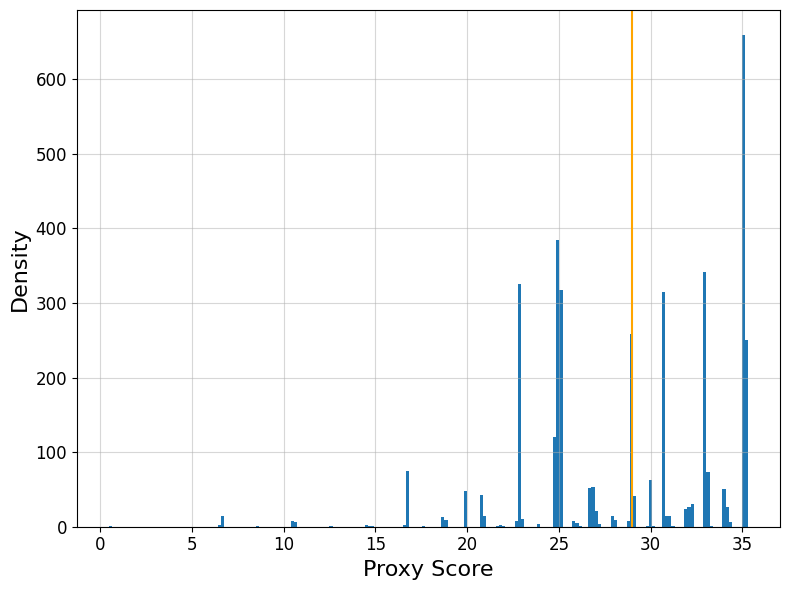

In [196]:
fig,ax = plt.subplots(figsize=(8, 6)) 

plt.hist(df_50_100['proxy'], bins=200, density=False)

plt.axvline(df_50_100['proxy'].mean(), color='orange')

plt.xlabel(f'Proxy Score', fontsize=16)
plt.ylabel(f'Density', fontsize=16)

ax.tick_params(axis='both', which='major', labelsize=12)
ax.tick_params(axis='both', which='minor', labelsize=12)

plt.grid(alpha=0.5)

plt.tight_layout()
plt.show()

In [197]:
def normalize(x: np.array) -> np.array:
    return (x - x.min()) / (x.max() - x.min()) * 100

In [198]:
def standardize(x: np.array) -> np.array:
    return (x - x.mean())/(x.std())

In [199]:
df_50_100 = df_50_100.rename({'totalBytesNullable': 'n_bytes_total'})

Compute timeliness attribute from `lastUpdated` column

In [200]:
def compute_timeliness_attribute(last_update_time):
    # Difference between current time and last update time
    current_time = time.time()
    last_update_time = time.strptime(last_update_time, '%Y-%m-%d %H:%M:%S')
    last_update_time = time.mktime(last_update_time)
    return current_time - last_update_time

In [201]:
df_50_100 = df_50_100.with_columns(pl.col('lastUpdated').apply(compute_timeliness_attribute).alias('since_last_update'))

In [202]:
df_50_100 = df_50_100.drop('lastUpdated')

In [203]:
df_50_100 = df_50_100.drop(['is_file_unstructured', 'time_diff_current_and_last_update'])

Find NaNs

In [204]:
df_50_100['ref_no_slash'].dtype

Utf8

In [205]:
for col in df_50_100.columns:
    if df_50_100[col].dtype == pl.Utf8 or df_50_100[col].dtype == pl.Int64:
        if df_50_100[col].is_null().sum() > 0:
            print(col)
    elif df_50_100[col].is_nan().sum() > 0:
        print(col)

avg_variance_numerical_features
avg_skewness_numerical_features
avg_kurtosis_numerical_features
avg_margin_error_numerical_features


In [206]:
cols_with_nulls =  ['avg_variance_numerical_features', 'avg_skewness_numerical_features', 'avg_kurtosis_numerical_features', 'avg_margin_error_numerical_features']
df_50_100 = df_50_100.with_columns(
    [
        pl.col('avg_variance_numerical_features').fill_nan(pl.lit(0)).alias('avg_variance_numerical_features'),
        pl.col('avg_skewness_numerical_features').fill_nan(pl.lit(0)).alias('avg_skewness_numerical_features'),
        pl.col('avg_kurtosis_numerical_features').fill_nan(pl.lit(0)).alias('avg_kurtosis_numerical_features'),
        pl.col('avg_margin_error_numerical_features').fill_nan(pl.lit(0)).alias('avg_margin_error_numerical_features'),
    ]
)
    

Create aggregated attributes set

In [207]:
df_50_100.columns

['n_int_features',
 'n_float_features',
 'n_string_features',
 'n_datetime_features',
 'n_unknown_features',
 'n_categorical_features',
 'n_noncateg_features',
 'is_datetime_consistent',
 'n_ordered_features',
 'file_type',
 'is_file_structured',
 'is_file_semi_structured',
 'encoding',
 'has_duplicated_rows',
 'has_null_rows',
 'has_null_feature_values',
 'n_features',
 'n_rows',
 'n_rows_times_features',
 'avg_ratio_duplication_noncateg_features',
 'avg_ratio_duplication_categ_features',
 'ratio_features_at_least_one_null',
 'avg_ratio_null_values_features',
 'avg_variance_numerical_features',
 'avg_skewness_numerical_features',
 'avg_kurtosis_numerical_features',
 'avg_median_dev_numerical_features',
 'avg_n_outliers_numerical_features',
 'avg_unalikeability_categ_features',
 'avg_margin_error_numerical_features',
 'avg_gini_impurity_categ_features',
 'num_pii_entities',
 'profiler_sample_size',
 'num_sample_files',
 'ref_no_slash',
 'proxy',
 'n_bytes_total',
 'since_last_update']

In [208]:
q = (
    df_50_100.lazy()
    .groupby("ref_no_slash")
    .agg(
        [   
            pl.col('n_int_features').sum().alias('n_int_features'),
            pl.col('n_float_features').sum().alias('n_float_features'),
            pl.col('n_string_features').sum().alias('n_string_features'),
            pl.col('n_datetime_features').sum().alias('n_datetime_features'),
            pl.col('n_unknown_features').sum().alias('n_unknown_features'),
            pl.col('n_categorical_features').sum().alias('n_categorical_features'),
            pl.col('n_noncateg_features').sum().alias('n_noncateg_features'),
            (pl.col('is_datetime_consistent').sum() / pl.col('num_sample_files').sum()).alias('is_datetime_consistent'),
            pl.col('n_ordered_features').sum().alias('n_ordered_features'),
            (pl.col('has_duplicated_rows').sum() / pl.col('num_sample_files').sum()).alias('has_duplicated_rows'),
            (pl.col('has_null_rows').sum() / pl.col('num_sample_files').sum()).alias('has_null_rows'),
            (pl.col('has_null_feature_values').sum() / pl.col('num_sample_files').sum()).alias('has_null_feature_values'),
            pl.col('n_features').sum().alias('n_features'),
            (pl.col('n_features').sum() / pl.col('num_sample_files').sum()).alias('avg_n_features'),
            pl.col('n_rows').sum().alias('n_rows'),
            (pl.col('n_rows').sum() / pl.col('num_sample_files').sum()).alias('avg_n_rows'),
            pl.col('n_rows_times_features').sum().alias('n_rows_times_features'),
            (pl.col('n_rows_times_features').sum() / pl.col('num_sample_files').sum()).alias('avg_n_rows_times_features'),
            (pl.col('avg_ratio_duplication_noncateg_features').sum() / pl.col('num_sample_files').sum()).alias('avg_ratio_duplication_noncateg_features'),
            (pl.col('avg_ratio_duplication_categ_features').sum() / pl.col('num_sample_files').sum()).alias('avg_ratio_duplication_categ_features'),
            (pl.col('ratio_features_at_least_one_null').sum() / pl.col('num_sample_files').sum()).alias('ratio_features_at_least_one_null'),
            (pl.col('avg_ratio_null_values_features').sum() / pl.col('num_sample_files').sum()).alias('avg_ratio_null_values_features'),
            (pl.col('avg_variance_numerical_features').sum() / pl.col('num_sample_files').sum()).alias('avg_variance_numerical_features'),
            (pl.col('avg_skewness_numerical_features').sum() / pl.col('num_sample_files').sum()).alias('avg_skewness_numerical_features'),
            (pl.col('avg_kurtosis_numerical_features').sum() / pl.col('num_sample_files').sum()).alias('avg_kurtosis_numerical_features'),
            (pl.col('avg_median_dev_numerical_features').sum() / pl.col('num_sample_files').sum()).alias('avg_median_dev_numerical_features'),
            (pl.col('avg_n_outliers_numerical_features').sum() / pl.col('num_sample_files').sum()).alias('avg_n_outliers_numerical_features'),
            (pl.col('avg_unalikeability_categ_features').sum() / pl.col('num_sample_files').sum()).alias('avg_unalikeability_categ_features'),
            (pl.col('avg_margin_error_numerical_features').sum() / pl.col('num_sample_files').sum()).alias('avg_margin_error_numerical_features'),
            (pl.col('avg_gini_impurity_categ_features').sum() / pl.col('num_sample_files').sum()).alias('avg_gini_impurity_categ_features'),
            (pl.col('num_pii_entities').sum() / pl.col('num_sample_files').sum()).alias('avg_num_pii_entities'),
            pl.col('n_bytes_total').first().alias('n_bytes_total'),
            pl.col('since_last_update').first().alias('since_last_update'),
            pl.col('profiler_sample_size').sum().alias('profiler_sample_size'),
            pl.col('proxy').first().alias('proxy'),
        ]
    )
    .sort("proxy", descending=True)
)
df_50_100_agg = q.collect()

In [209]:
df_50_100_agg.null_count()

ref_no_slash,n_int_features,n_float_features,n_string_features,n_datetime_features,n_unknown_features,n_categorical_features,n_noncateg_features,is_datetime_consistent,n_ordered_features,has_duplicated_rows,has_null_rows,has_null_feature_values,n_features,avg_n_features,n_rows,avg_n_rows,n_rows_times_features,avg_n_rows_times_features,avg_ratio_duplication_noncateg_features,avg_ratio_duplication_categ_features,ratio_features_at_least_one_null,avg_ratio_null_values_features,avg_variance_numerical_features,avg_skewness_numerical_features,avg_kurtosis_numerical_features,avg_median_dev_numerical_features,avg_n_outliers_numerical_features,avg_unalikeability_categ_features,avg_margin_error_numerical_features,avg_gini_impurity_categ_features,avg_num_pii_entities,n_bytes_total,since_last_update,profiler_sample_size,proxy
u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [210]:
(df_50_100_agg['avg_ratio_duplication_noncateg_features'].to_numpy() < 0).sum()

0

In [211]:
df_50_100_agg = df_50_100_agg.drop(['totalBytesNullable', 'lastUpdated'])

SchemaFieldNotFoundError: totalBytesNullable

In [212]:
df_50_100_agg.sort('proxy', descending=True).head(10)['ref_no_slash'].to_numpy()

array(['raddar_ncaa-women-538-team-ratings',
       'gpreda_coronavirus-2019ncov', 'ghopkins_nba-injuries-2010-2018',
       'thedevastator_global-fossil-co2-emissions-by-country-2002-2022',
       'chaibapat_slogan-dataset',
       'iamsouravbanerjee_fifa-football-world-cup-dataset',
       'itssuru_loan-data', 'imohtn_video-games-rating-by-esrb',
       'mpwolke_cusersmarildownloadspopolazionecsv',
       'surajjha101_fortune-top-1000-companies-by-revenue-2022'],
      dtype=object)

In [213]:
df_50_100_agg.filter(pl.col('ref_no_slash') == 'mohamedkhaledelsafty_top-10-tech-subreddits')

ref_no_slash,n_int_features,n_float_features,n_string_features,n_datetime_features,n_unknown_features,n_categorical_features,n_noncateg_features,is_datetime_consistent,n_ordered_features,has_duplicated_rows,has_null_rows,has_null_feature_values,n_features,avg_n_features,n_rows,avg_n_rows,n_rows_times_features,avg_n_rows_times_features,avg_ratio_duplication_noncateg_features,avg_ratio_duplication_categ_features,ratio_features_at_least_one_null,avg_ratio_null_values_features,avg_variance_numerical_features,avg_skewness_numerical_features,avg_kurtosis_numerical_features,avg_median_dev_numerical_features,avg_n_outliers_numerical_features,avg_unalikeability_categ_features,avg_margin_error_numerical_features,avg_gini_impurity_categ_features,avg_num_pii_entities,n_bytes_total,since_last_update,profiler_sample_size,proxy
str,i64,i64,i64,i64,i64,i64,i64,f64,i64,f64,f64,f64,i64,f64,i64,f64,i64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,i64,f64,i64,f64
"""mohamedkhalede...",44,0,0,0,66,34,76,0.090909,23,0.0,0.0,0.082645,110,0.909091,110,0.909091,1100,9.090909,0.075131,0.012671,0.064683,0.746116,0.0,0.0,0.0,0.0,0.0,0.02418,0.0,0.022171,0.056311,20909611,1.5721e7,14006,29.960858


In [214]:
df_50_100_agg = df_50_100_agg.filter(pl.col('avg_ratio_null_values_features') <= 1)
df_50_100_agg.shape

(541, 36)

Downsample high proxy values (remove outliers)

In [38]:
df_50_100_agg = df_50_100_agg.filter(pl.col('proxy') >= 35).sample(frac=0.1).vstack(df_50_100_agg.filter(pl.col('proxy') < 35))
df_50_100_agg.shape

(306, 36)

Check proxy distirbution after downsampling

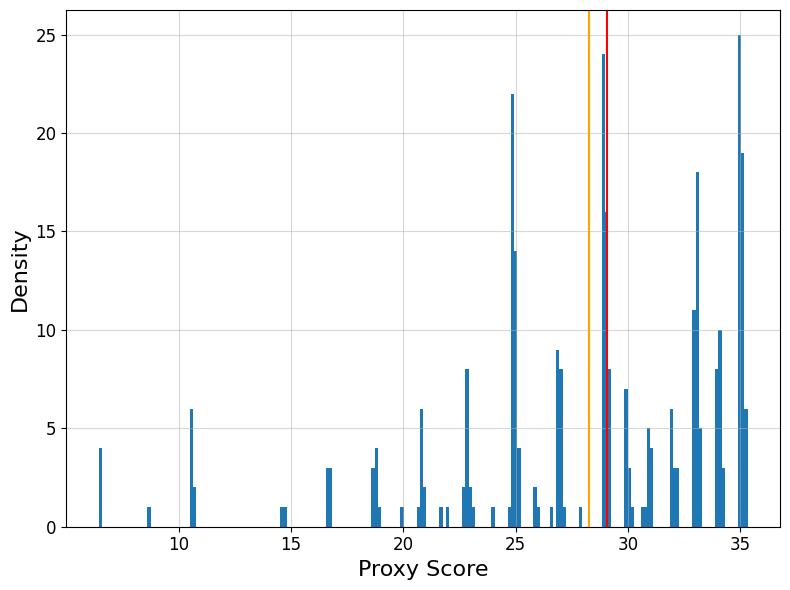

In [39]:
fig,ax = plt.subplots(figsize=(8, 6)) 

plt.hist(df_50_100_agg['proxy'], bins=200, density=False)

plt.axvline(df_50_100_agg['proxy'].mean(), color='orange')
plt.axvline(df_50_100_agg['proxy'].median(), color='red')


plt.xlabel(f'Proxy Score', fontsize=16)
plt.ylabel(f'Density', fontsize=16)

ax.tick_params(axis='both', which='major', labelsize=12)
ax.tick_params(axis='both', which='minor', labelsize=12)

plt.grid(alpha=0.5)

plt.tight_layout()
plt.show()

Add position relative to median based on proxy

In [215]:
proxy_median = df_50_100_agg['proxy'].median()
df_50_100_agg = df_50_100_agg.with_columns(
    pl.col('proxy').apply(lambda v: 1 if v >= proxy_median else 0).alias('proxy_class')
)
df_50_100_agg

ref_no_slash,n_int_features,n_float_features,n_string_features,n_datetime_features,n_unknown_features,n_categorical_features,n_noncateg_features,is_datetime_consistent,n_ordered_features,has_duplicated_rows,has_null_rows,has_null_feature_values,n_features,avg_n_features,n_rows,avg_n_rows,n_rows_times_features,avg_n_rows_times_features,avg_ratio_duplication_noncateg_features,avg_ratio_duplication_categ_features,ratio_features_at_least_one_null,avg_ratio_null_values_features,avg_variance_numerical_features,avg_skewness_numerical_features,avg_kurtosis_numerical_features,avg_median_dev_numerical_features,avg_n_outliers_numerical_features,avg_unalikeability_categ_features,avg_margin_error_numerical_features,avg_gini_impurity_categ_features,avg_num_pii_entities,n_bytes_total,since_last_update,profiler_sample_size,proxy,proxy_class
str,i64,i64,i64,i64,i64,i64,i64,f64,i64,f64,f64,f64,i64,f64,i64,f64,i64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,i64,f64,i64,f64,i64
"""raddar_ncaa-wo...",2,1,0,0,1,1,3,1.0,1,0.0,0.0,0.0,4,4.0,4,4.0,16,16.0,0.568713,0.015351,0.0,0.0,33.42692,0.012581,0.007409,2.03599,0.333333,0.858917,0.020047,0.857033,0.04386,4162,2.5402e6,456,35.31476,1
"""chaibapat_slog...",0,0,0,0,2,0,2,0.5,0,0.5,0.0,0.0,2,1.0,2,1.0,4,2.0,0.244621,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.042,18295,2.2523e6,1162,35.308046,1
"""iamsouravbaner...",181,1,0,0,47,139,90,0.043478,57,0.0,0.0,0.0,229,0.432892,229,0.432892,2281,4.311909,0.035036,0.012748,0.0,0.0,0.000249,0.000551,0.000485,0.000077,0.000378,0.032767,0.000079,0.03112,0.002334,13334,9.6700e6,511,35.308046,1
"""itssuru_loan-d...",7,6,0,0,1,9,5,1.0,1,0.0,0.0,0.0,14,14.0,14,14.0,196,196.0,0.4147,0.016055,0.0,0.0,482905.686879,0.180378,0.110701,123.652363,0.461538,0.594576,0.015305,0.594514,2.338,218250,6.0476e7,9578,35.308046,1
"""imohtn_video-g...",64,0,0,0,0,66,2,0.027027,1,0.013514,0.0,0.0,68,0.918919,68,0.918919,2312,31.243243,0.026865,0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.004075,0.0,0.00407,0.043649,42863,6.9580e7,2395,35.308046,1
"""mpwolke_cusers...",0,0,0,0,1,0,1,1.0,0,0.0,0.0,0.0,1,1.0,1,1.0,1,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2312373,1.1119e8,267234,35.301332,1
"""shivamb_5minut...",11,2,0,0,2,12,3,1.0,0,0.0,0.0,0.0,15,15.0,15,15.0,225,225.0,0.99913,0.024156,0.0,0.0,0.044759,0.073241,0.167395,0.044321,0.153846,0.680461,0.048118,0.680324,10.995,203466,4.3339e7,4978,35.301332,1
"""funxexcel_data...",24,0,0,0,17,31,10,0.027027,13,0.0,0.0,0.013514,41,0.554054,41,0.554054,901,12.175676,0.026938,0.007733,0.013514,0.013414,0.0,0.0,0.0,0.0,0.0,0.003458,0.0,0.003401,0.154409,27397,9.5143e7,122,35.294617,1
"""tejashvi14_emp...",5,0,0,0,4,9,0,1.0,0,1.0,0.0,0.0,9,9.0,9,9.0,81,81.0,0.0,0.001194,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.565226,0.0,0.565105,0.0,18961,4.7473e7,4653,35.294617,1


### **Preprocessing**

In [260]:
df_50_100_agg.shape

(306, 36)

Imputate with mean column `avg_margin_error_numerical_features`

In [261]:
avg_margin_error_numerical_features_mean = df_50_100.filter(
    pl.col('avg_margin_error_numerical_features').is_not_nan()
    & pl.col('avg_margin_error_numerical_features').is_not_null()
)['avg_margin_error_numerical_features'].mean()

df_50_100 = df_50_100.with_columns(pl.col("avg_margin_error_numerical_features").fill_nan(pl.lit(avg_margin_error_numerical_features_mean)).alias('avg_margin_error_numerical_features'))

In [262]:
df_50_100_agg['avg_margin_error_numerical_features'].is_nan().sum()

0

Normalize attributes to 0-100

In [222]:
to_normalize = ['n_int_features', 'n_float_features', 'n_categorical_features', 'n_noncateg_features', 'n_rows_times_features', 'avg_variance_numerical_features', 'avg_skewness_numerical_features']

In [223]:
for col in to_normalize:
    col_normalized_0_100 = normalize(df_50_100[col].to_numpy())
    df_50_100  = df_50_100.drop(col).with_columns(pl.Series(col, col_normalized_0_100))

Encode categorical attributes:
['filte_type', 'encoding']

In [224]:
# Encode Gender
encoder1 = OneHotEncoder(handle_unknown='error', sparse_output=False)
file_type_oh = encoder1.fit_transform(df_50_100['file_type'].to_numpy().reshape(-1, 1))

encoder2 = OneHotEncoder(handle_unknown='error', sparse_output=False)
encoding_oh = encoder2.fit_transform(df_50_100['encoding'].to_numpy().reshape(-1, 1))

file_type_oh_df = pl.DataFrame(file_type_oh, columns=list(encoder1.get_feature_names_out()))
encoding_oh_df = pl.DataFrame(encoding_oh, columns=list(encoder2.get_feature_names_out()))

df_50_100_enc = pl.concat([df_50_100, file_type_oh_df, encoding_oh_df], how='horizontal').drop(['file_type', 'encoding', 'num_sample_files'])
df_50_100_enc.columns

C:\Users\radue\AppData\Local\Temp\ipykernel_13204\1723918752.py:8: DeprecationWarning: `columns` is deprecated as an argument to `__init__`; use `schema` instead.
  file_type_oh_df = pl.DataFrame(file_type_oh, columns=list(encoder1.get_feature_names_out()))
C:\Users\radue\AppData\Local\Temp\ipykernel_13204\1723918752.py:9: DeprecationWarning: `columns` is deprecated as an argument to `__init__`; use `schema` instead.
  encoding_oh_df = pl.DataFrame(encoding_oh, columns=list(encoder2.get_feature_names_out()))


['n_string_features',
 'n_datetime_features',
 'n_unknown_features',
 'is_datetime_consistent',
 'n_ordered_features',
 'is_file_structured',
 'is_file_semi_structured',
 'has_duplicated_rows',
 'has_null_rows',
 'has_null_feature_values',
 'n_features',
 'n_rows',
 'avg_ratio_duplication_noncateg_features',
 'avg_ratio_duplication_categ_features',
 'ratio_features_at_least_one_null',
 'avg_ratio_null_values_features',
 'avg_kurtosis_numerical_features',
 'avg_median_dev_numerical_features',
 'avg_n_outliers_numerical_features',
 'avg_unalikeability_categ_features',
 'avg_margin_error_numerical_features',
 'avg_gini_impurity_categ_features',
 'num_pii_entities',
 'profiler_sample_size',
 'ref_no_slash',
 'proxy',
 'n_bytes_total',
 'since_last_update',
 'n_int_features',
 'n_float_features',
 'n_categorical_features',
 'n_noncateg_features',
 'n_rows_times_features',
 'avg_variance_numerical_features',
 'avg_skewness_numerical_features',
 'x0_',
 'x0_csv',
 'x0_json',
 'x0_parquet',
 '

Aggregate encoded dataframe

In [ ]:
df_50_100_enc_agg = df_50_100_enc.groupby('ref_no_slash', maintain_order=True).mean()
df_50_100_enc_agg

In [ ]:
for col in df_50_100_agg.columns:
    df_50_100_agg[col].append()

### **Model** Data

In [217]:
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

1. **Classification**

In [304]:
df_50_100_agg_shuffled = df_50_100_agg.sample(frac=1, shuffle=True)

df_50_100_agg_shuffled_class_1 = df_50_100_agg_shuffled.filter(pl.col('proxy_class') == 1)
df_50_100_agg_shuffled_class_0 = df_50_100_agg_shuffled.filter(pl.col('proxy_class') == 0)

features = [
    pl.col('n_int_features'),
    pl.col('n_float_features'),
    pl.col('n_datetime_features'),
    pl.col('n_unknown_features'),
    pl.col('n_categorical_features'),
    pl.col('n_noncateg_features'),
    pl.col('is_datetime_consistent'),
    pl.col('n_ordered_features'),
    pl.col('has_duplicated_rows'),
    pl.col('has_null_rows'),
    pl.col('has_null_feature_values'),
    pl.col('avg_n_features'),
    pl.col('avg_n_rows'),
    pl.col('avg_n_rows_times_features'),
    pl.col('avg_ratio_duplication_noncateg_features'),
    pl.col('avg_ratio_duplication_categ_features'),
    pl.col('ratio_features_at_least_one_null'),
    pl.col('avg_ratio_null_values_features'),
    pl.col('avg_variance_numerical_features'),
    pl.col('avg_skewness_numerical_features'),
    pl.col('avg_kurtosis_numerical_features'),
    pl.col('avg_median_dev_numerical_features'),
    pl.col('avg_n_outliers_numerical_features'),
    pl.col('avg_unalikeability_categ_features'),
    pl.col('avg_margin_error_numerical_features'),
    pl.col('avg_gini_impurity_categ_features'),
    pl.col('n_bytes_total'),
    pl.col('since_last_update'),
    pl.col('avg_num_pii_entities'),
]

X_1 = df_50_100_agg_shuffled_class_1.sample(frac=1, shuffle=True).select(features)
X_0 = df_50_100_agg_shuffled_class_0.sample(frac=1, shuffle=True).select(features)

X = pl.concat([X_1, X_0], how='vertical').sample(frac=1, shuffle=True)

y_1 = df_50_100_agg_shuffled_class_1['proxy_class']
y_0 = df_50_100_agg_shuffled_class_0['proxy_class']

y = pl.concat([y_1, y_0], how='vertical').sample(frac=1, shuffle=True)

In [305]:
X_1.shape, X_0.shape, y_1.shape, y_0.shape

((273, 29), (268, 29), (273,), (268,))

Train, test split

In [312]:
train_size_single_class = 220 # *2 for total training size
test_size = df_50_100_agg_shuffled.shape[0] - test_size

In [313]:
X_train = pl.concat([
        X_1[:train_size_single_class], 
        X_0[:train_size_single_class]
    ],
    how='vertical'
).sample(frac=1, shuffle=True).to_numpy()

X_test = pl.concat([
        X_1[train_size_single_class:], 
        X_0[train_size_single_class:]
    ],
    how='vertical'
).sample(frac=1, shuffle=True).to_numpy()


y_train = pl.concat([
        y_1[:train_size_single_class],
        y_0[:train_size_single_class]
    ],
    how='vertical'
).sample(frac=1, shuffle=True).to_numpy().squeeze()

y_test = pl.concat([
        y_1[train_size_single_class:],
        y_0[train_size_single_class:]
    ],
    how='vertical'
).sample(frac=1, shuffle=True).to_numpy().squeeze()

X_train.shape, X_test.shape, y_train.shape, y_test.shape

((440, 29), (101, 29), (440,), (101,))

In [314]:
kernel = 1.0 * RBF(1.0)
gpc = GaussianProcessClassifier(kernel=kernel, random_state=42)
gpc.fit(X_train, y_train)

GaussianProcessClassifier(kernel=1**2 * RBF(length_scale=1), random_state=42)

In [315]:
y_pred = gpc.predict(X_train)
print('Training')
print('------------')
print(classification_report(y_train, y_pred))

y_pred = gpc.predict(X_test)
print('Testing')
print('------------')
print(classification_report(y_test, y_pred))

Training
------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       220
           1       1.00      1.00      1.00       220

    accuracy                           1.00       440
   macro avg       1.00      1.00      1.00       440
weighted avg       1.00      1.00      1.00       440

Testing
------------
              precision    recall  f1-score   support

           0       0.48      1.00      0.64        48
           1       0.00      0.00      0.00        53

    accuracy                           0.48       101
   macro avg       0.24      0.50      0.32       101
weighted avg       0.23      0.48      0.31       101



c:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [310]:
import xgboost as xgb

In [311]:

xgb_model = xgb.XGBRegressor(objective="reg:absoluteerror", random_state=42)
xgb_model.fit(X_train, y_train)

pred_values = xgb_model.predict(X_test)
pred_labels = np.round(pred_values)

print(classification_report(y_test, y_pred))


              precision    recall  f1-score   support

           0       0.48      1.00      0.65        68
           1       0.00      0.00      0.00        73

    accuracy                           0.48       141
   macro avg       0.24      0.50      0.33       141
weighted avg       0.23      0.48      0.31       141



c:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


krr = 

### **Analysis**

Heat Map

In [41]:
df_heat_map = df_50_100_agg.drop(
    [
        'ref_no_slash', 'n_string_features'
    ]).to_pandas()

<Axes: >

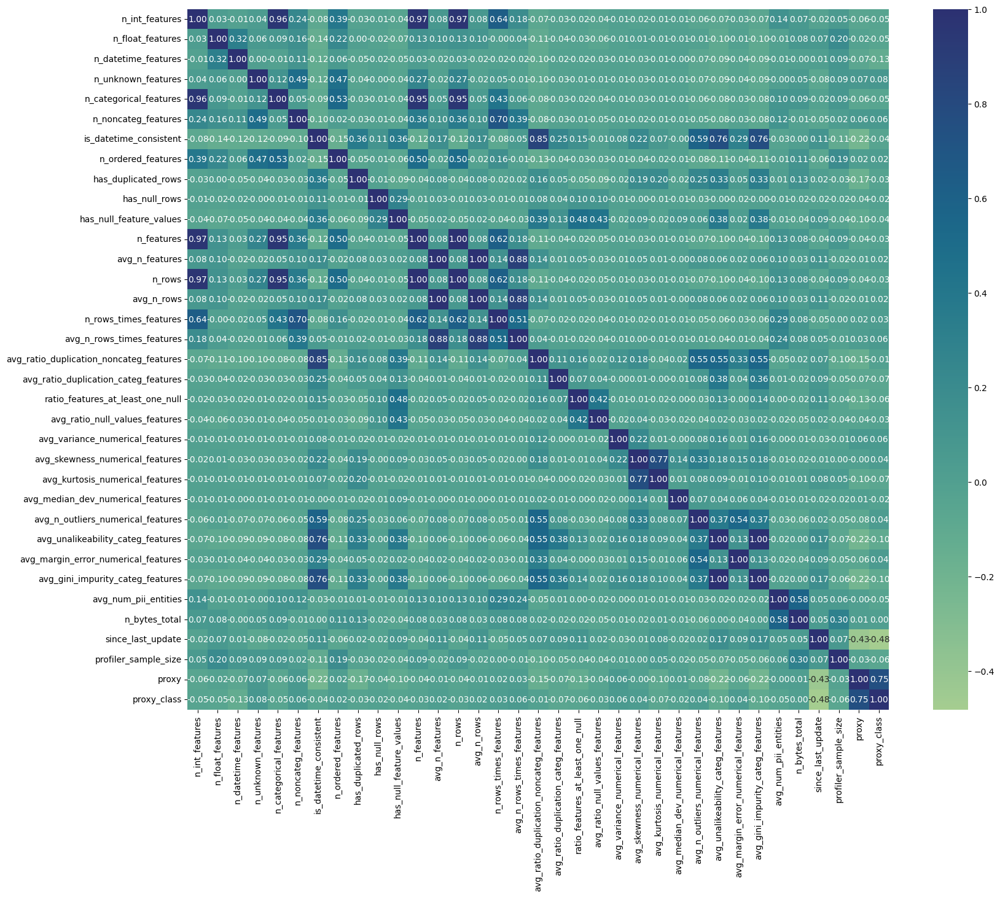

In [42]:
fig, ax = plt.subplots(figsize=(15,12))   
plt.tight_layout()

sns.heatmap(df_heat_map.corr(), annot=True, cmap="crest", fmt='.2f', ax=ax)

Multi-plots for attributes
['avg_kurtosis_numerical_features', 'n_features', 'n_rows_times_features', 'avg_ratio_null_values_features'
'avg_variance_numerical_features', 'avg_variance_numerical_features', 'avg_skewness_numerical_features'
'avg_kurtosis_numerical_features', 'avg_median_dev_numerical_features, 'avg_n_outliers_numerical_features'
'avg_unalikeability_categ_features', 'avg_margin_error_numerical_features', 'avg_gini_impurity_categ_features'
'time_diff_current_and_last_update', 'num_pii_entities']

In [43]:
cols = ['n_features', 'n_rows_times_features', 'avg_ratio_null_values_features', 'avg_ratio_duplication_noncateg_features'
        'avg_ratio_duplication_categ_features' 'avg_variance_numerical_features', 'avg_skewness_numerical_features'
'avg_kurtosis_numerical_features', 'avg_median_dev_numerical_features', 'avg_n_outliers_numerical_features',
'avg_unalikeability_categ_features', 'avg_margin_error_numerical_features', 'avg_gini_impurity_categ_features'
'since_last_update	', 'num_pii_entities']

In [44]:
# fig, axs = plt.subplots(ncols=5, nrows=3)

# # df_plot = df_50_100.filter(pl.col('avg_kurtosis_numerical_features') < 40)

# sns.jointplot(x=df_50_100['n_features'], y=df_50_100['proxy'], alpha=0.7, kind='scatter', ax=axs[0][0])
# sns.jointplot(x=df_50_100['n_rows_times_features'], y=df_50_100['proxy'], alpha=0.7, kind='scatter', ax=axs[0][1])
# sns.jointplot(x=df_50_100['avg_ratio_null_values_features'], y=df_50_100['proxy'], alpha=0.7, kind='scatter', ax=axs[0][2])
# sns.jointplot(x=df_50_100['avg_ratio_duplication_noncateg_features'], y=df_50_100['proxy'], alpha=0.7, kind='scatter', ax=axs[0][3])
# sns.jointplot(x=df_50_100['avg_ratio_duplication_categ_features'], y=df_50_100['proxy'], alpha=0.7, kind='scatter', ax=axs[0][4])
# sns.jointplot(x=df_50_100['avg_variance_numerical_features'], y=df_50_100['proxy'], alpha=0.7, kind='scatter', ax=axs[1][0])
# sns.jointplot(x=df_50_100['avg_skewness_numerical_features'], y=df_50_100['proxy'], alpha=0.7, kind='scatter', ax=axs[1][1])
# sns.jointplot(x=df_50_100['avg_kurtosis_numerical_features'], y=df_50_100['proxy'], alpha=0.7, kind='scatter', ax=axs[1][2])
# sns.jointplot(x=df_50_100['avg_median_dev_numerical_features'], y=df_50_100['proxy'], alpha=0.7, kind='scatter', ax=axs[1][3])
# sns.jointplot(x=df_50_100['avg_n_outliers_numerical_features'], y=df_50_100['proxy'], alpha=0.7, kind='scatter', ax=axs[1][4])
# sns.jointplot(x=df_50_100['avg_unalikeability_categ_features'], y=df_50_100['proxy'], alpha=0.7, kind='scatter', ax=axs[2][0])
# sns.jointplot(x=df_50_100['avg_margin_error_numerical_features'], y=df_50_100['proxy'], alpha=0.7, kind='scatter', ax=axs[2][1])
# sns.jointplot(x=df_50_100['avg_gini_impurity_categ_features'], y=df_50_100['proxy'], alpha=0.7, kind='scatter', ax=axs[2][2])
# sns.jointplot(x=df_50_100['since_last_update'], y=df_50_100['proxy'], alpha=0.7, kind='scatter', ax=axs[2][3])
# sns.jointplot(x=df_50_100['num_pii_entities'], y=df_50_100['proxy'], alpha=0.7, kind='scatter', ax=axs[2][4])

# plt.grid(alpha=0.5)

`avg_n_features`

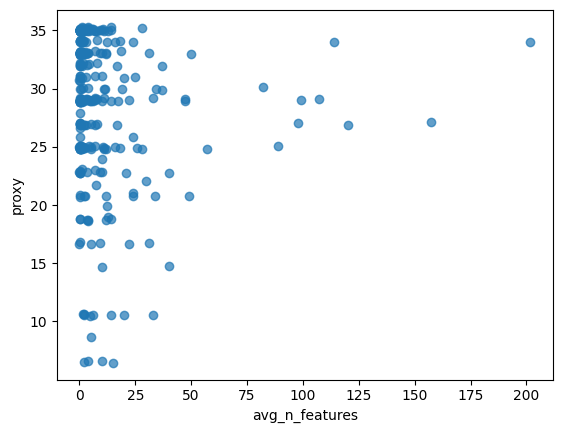

In [45]:
df_plot = df_50_100_agg.filter(pl.col('avg_n_features') < 400)#.filter((pl.col('proxy') > 24) & (pl.col('avg_n_features') < 400))
plt.scatter(df_plot['avg_n_features'].to_numpy(), y=df_plot['proxy'].to_numpy(), alpha=0.7)
plt.xlabel('avg_n_features')
plt.ylabel('proxy')
plt.show()

`avg_n_rows_times_features`

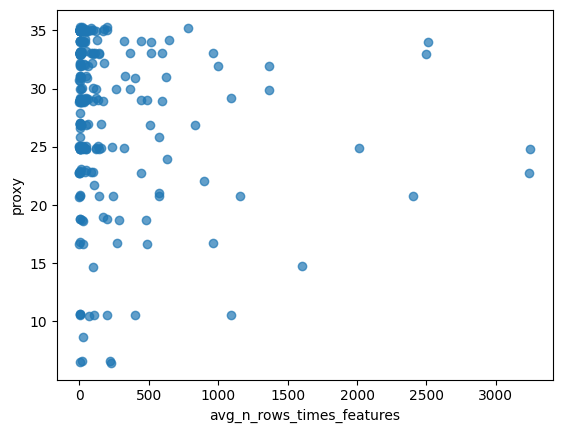

In [46]:
df_plot = df_50_100_agg.filter(pl.col('avg_n_rows_times_features') < 4000)
plt.scatter(df_plot['avg_n_rows_times_features'].to_numpy(), y=df_plot['proxy'].to_numpy(), alpha=0.7)
plt.xlabel('avg_n_rows_times_features')
plt.ylabel('proxy')
plt.show()

cols = ['n_features', 'n_rows_times_features', 'avg_ratio_null_values_features', 'avg_ratio_duplication_noncateg_features'
        'avg_ratio_duplication_categ_features' 'avg_variance_numerical_features', 'avg_skewness_numerical_features'
'avg_kurtosis_numerical_features', 'avg_median_dev_numerical_features', 'avg_n_outliers_numerical_features',
'avg_unalikeability_categ_features', 'avg_margin_error_numerical_features', 'avg_gini_impurity_categ_features'
'since_last_update	', 'num_pii_entities']

`avg_ratio_null_values_features`

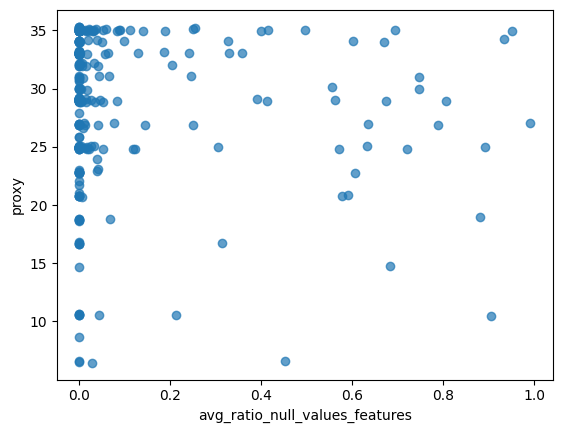

Text(0, 0.5, 'proxy')

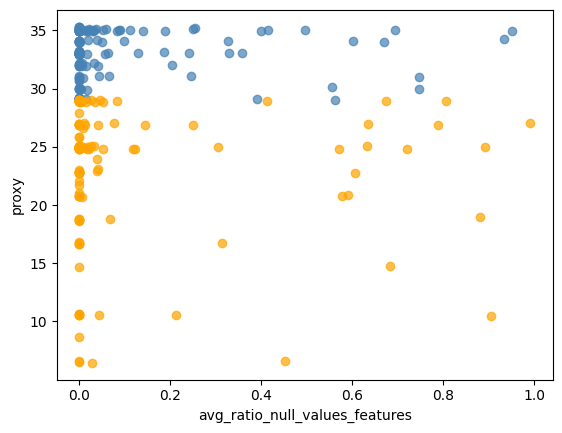

In [47]:
df_plot = df_50_100_agg.filter(pl.col('n_rows_times_features') < 200000)
# sns.jointplot(x=df_plot['avg_ratio_null_values_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
plt.scatter(df_plot['avg_ratio_null_values_features'].to_numpy(), y=df_plot['proxy'].to_numpy(), alpha=0.7)
plt.xlabel('avg_ratio_null_values_features')
plt.ylabel('proxy')
plt.show()

df_plot = df_50_100_agg.filter(pl.col('n_rows_times_features') < 200000)
# sns.jointplot(x=df_plot['avg_ratio_null_values_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
plt.scatter(
    df_plot.filter(pl.col('proxy_class') == 1)['avg_ratio_null_values_features'].to_numpy(), 
     y=df_plot.filter(pl.col('proxy_class') == 1)['proxy'].to_numpy(), 
    alpha=0.7, 
    color='steelblue')
plt.scatter(
    df_plot.filter(pl.col('proxy_class') == 0)['avg_ratio_null_values_features'].to_numpy(), 
    y=df_plot.filter(pl.col('proxy_class') == 0)['proxy'].to_numpy(), 
    alpha=0.7, 
    color='orange')

plt.xlabel('avg_ratio_null_values_features')
plt.ylabel('proxy')

`avg_ratio_duplication_noncateg_features`

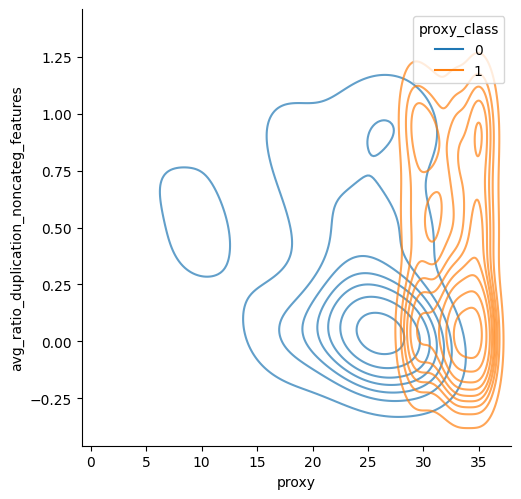

In [48]:

df_plot = df_50_100_agg#.filter(pl.col('n_rows_times_features') < 200000)
g = sns.jointplot(
    data=df_plot,
    y='avg_ratio_duplication_noncateg_features', 
    x='proxy', 
    alpha=0.7, hue='proxy_class', 
    kind='kde')
g.ax_marg_x.remove()
g.ax_marg_y.remove()

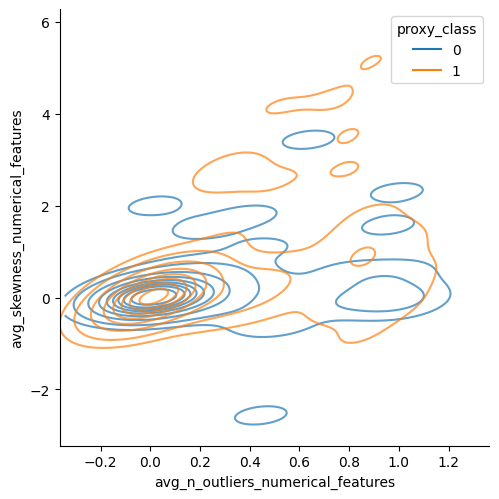

In [81]:

df_plot = df_50_100_agg#.filter(pl.col('n_rows_times_features') < 200000)
g = sns.jointplot(
    data=df_plot.filter(pl.col('avg_skewness_numerical_features') < 10),
    y='avg_skewness_numerical_features', 
    x='avg_n_outliers_numerical_features', 
    alpha=0.7, hue='proxy_class', 
    kind='kde')
g.ax_marg_x.remove()
g.ax_marg_y.remove()

In [98]:
df_plot.filter(pl.col('avg_n_outliers_numerical_features') > 0.7).filter(pl.col('proxy_class') == 0)

ref_no_slash,n_int_features,n_float_features,n_string_features,n_datetime_features,n_unknown_features,n_categorical_features,n_noncateg_features,is_datetime_consistent,n_ordered_features,has_duplicated_rows,has_null_rows,has_null_feature_values,n_features,avg_n_features,n_rows,avg_n_rows,n_rows_times_features,avg_n_rows_times_features,avg_ratio_duplication_noncateg_features,avg_ratio_duplication_categ_features,ratio_features_at_least_one_null,avg_ratio_null_values_features,avg_variance_numerical_features,avg_skewness_numerical_features,avg_kurtosis_numerical_features,avg_median_dev_numerical_features,avg_n_outliers_numerical_features,avg_unalikeability_categ_features,avg_margin_error_numerical_features,avg_gini_impurity_categ_features,avg_num_pii_entities,n_bytes_total,since_last_update,profiler_sample_size,proxy,proxy_class
str,i64,i64,i64,i64,i64,i64,i64,f64,i64,f64,f64,f64,i64,f64,i64,f64,i64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,i64,f64,i64,f64,i64
"""rtatman_us-can...",0,1,0,1,0,0,2,1.0,1,0.0,0.0,0.0,2,2.0,2,2.0,4,4.0,1.0,0.0,0.0,0.0,325.313605,-0.149634,-0.688417,13.456374,1.0,0.0,0.090592,0.0,0.0,3676,1.7356e8,548,29.033767,0
"""rsalaschile_fo...",3,96,0,0,0,38,61,1.0,0,0.0,0.0,0.0,99,99.0,99,99.0,9801,9801.0,0.540255,0.05611,0.0,0.0,871.035936,0.215497,1.758701,9.038312,0.969697,0.9696,0.025002,0.969384,0.297,405685,1.7691e8,4479,28.986766,0
"""pdquant_sp500-...",0,1,0,0,1,0,2,1.0,0,0.0,0.0,0.0,2,2.0,2,2.0,4,4.0,0.983459,0.0,0.0,0.0,380290.388145,0.563422,-0.222738,421.535619,1.0,0.0,0.0219811,0.0,0.002,41317,1.4384e8,8192,28.906192,0
"""dipayanbiswas_...",6,749,0,0,0,3,752,1.0,1,1.0,0.0,0.0,755,755.0,755,755.0,570025,570025.0,0.950071,0.047178,0.0,0.0,1.3129e16,2.295723,61.134111,3.8858e6,0.992053,0.53353,0.08573,0.532824,484.358466,2297378,1.2234e8,756,25.977202,0
"""gargmanas_park...",1,22,0,0,1,2,22,1.0,1,0.0,0.0,0.0,24,24.0,24,24.0,576,576.0,0.95338,0.053846,0.0,0.0,519.018003,1.572995,4.525804,4.452039,0.956522,0.625033,0.098649,0.621828,23.753846,15870,6.1805e7,195,25.849627,0
"""ritesaluja_ban...",1,4,0,0,0,1,4,1.0,1,1.0,0.0,0.0,5,5.0,5,5.0,25,25.0,0.914723,0.001458,0.0,0.0,13.093974,-0.095329,0.111918,2.038689,0.8,0.494223,0.028789,0.493863,0.0,19675,1.3790e8,1372,24.949396,0
"""faisaljanjua05...",1,4,0,1,1,1,6,1.0,2,0.0,0.0,0.0,7,7.0,7,7.0,49,49.0,0.844439,0.000175,0.0,0.0,215056.283324,-0.068378,-0.999081,361.016137,0.8,0.0,0.021321,0.0,0.042,89076,1.6947e7,5703,22.981068,0
"""mchilamwar_pre...",1,8,0,0,0,5,4,1.0,0,1.0,0.0,0.0,9,9.0,9,9.0,81,81.0,0.414806,0.12835,0.0,0.0,3963.476888,0.327648,-0.208531,24.773359,0.888889,0.819748,0.083347,0.818952,0.0,11359,4.2969e7,1030,22.813206,0
"""apratim87_hous...",3,11,0,0,0,7,7,1.0,0,0.0,0.0,0.0,14,14.0,14,14.0,196,196.0,0.779349,0.085997,0.0,0.0,709.547568,0.54123,3.53376,3.078111,0.785714,0.731598,0.060291,0.730149,0.055446,11793,2.0430e8,505,18.762406,0


`avg_gini_impurity_categ_features`

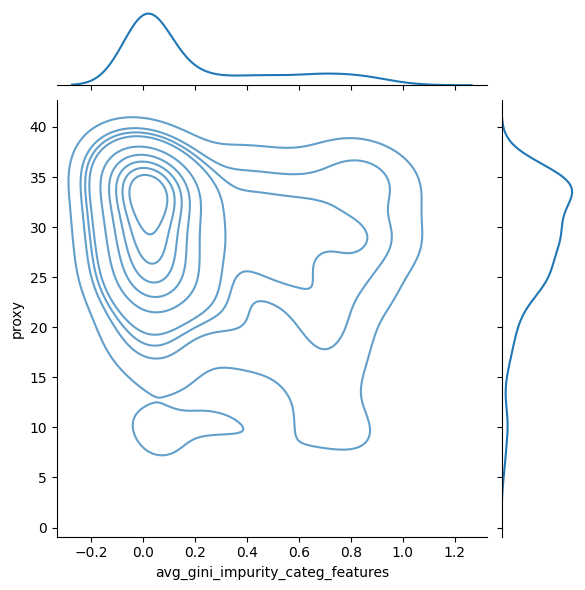

In [49]:
df_plot = df_50_100_agg#.filter(pl.col('n_rows_times_features') < 200000)
g = sns.jointplot(x=df_plot['avg_gini_impurity_categ_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')

`avg_variance_numerical_features`

Text(0, 0.5, 'proxy')

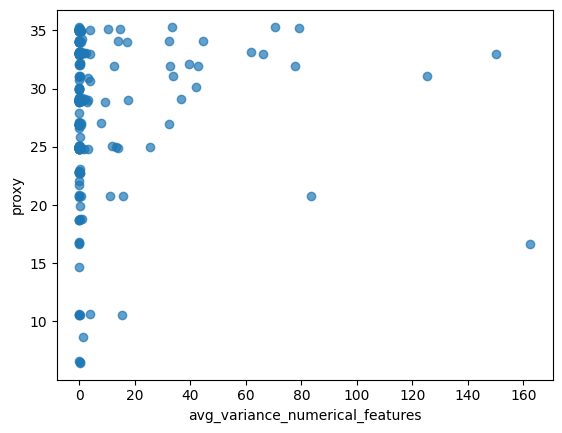

In [50]:
df_plot = df_50_100_agg.filter(pl.col('avg_variance_numerical_features') < 200)
# sns.jointplot(x=df_plot['avg_variance_numerical_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
plt.scatter(df_plot['avg_variance_numerical_features'].to_numpy(), y=df_plot['proxy'].to_numpy(), alpha=0.7)
plt.xlabel('avg_variance_numerical_features')
plt.ylabel('proxy')

`avg_unalikeability_categ_features`

Text(0, 0.5, 'proxy')

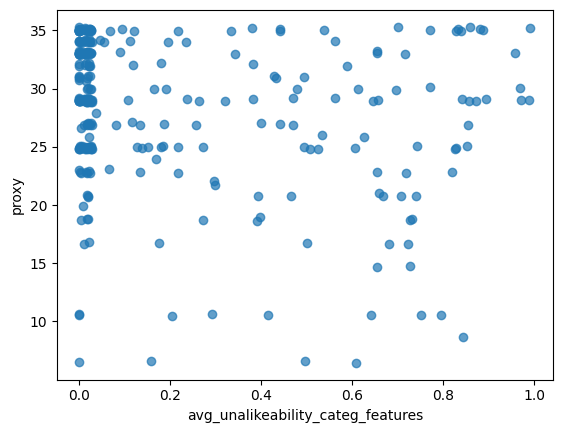

In [51]:
df_plot = df_50_100_agg#.filter(pl.col('avg_variance_numerical_features') < 1000)
# sns.jointplot(x=df_plot['avg_unalikeability_categ_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
plt.scatter(df_plot['avg_unalikeability_categ_features'].to_numpy(), y=df_plot['proxy'].to_numpy(), alpha=0.7)
plt.xlabel('avg_unalikeability_categ_features')
plt.ylabel('proxy')

`avg_skewness_numerical_features`

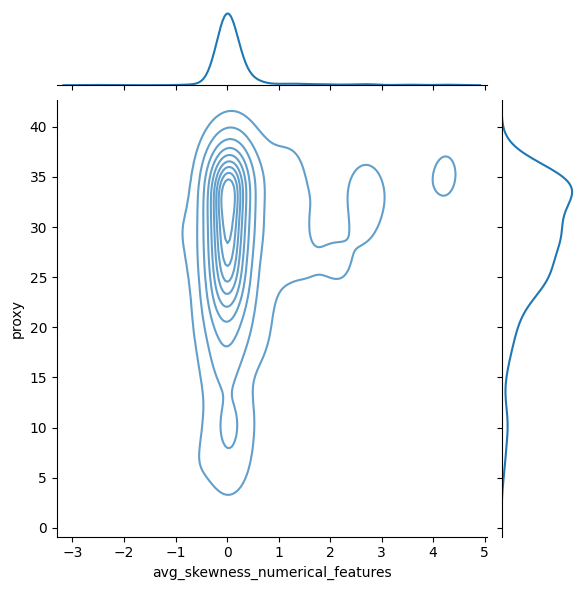

In [52]:
df_plot = df_50_100_agg.filter(pl.col('avg_skewness_numerical_features') < 5)
sns.jointplot(x=df_plot['avg_skewness_numerical_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')

`avg_kurtosis_numerical_features`

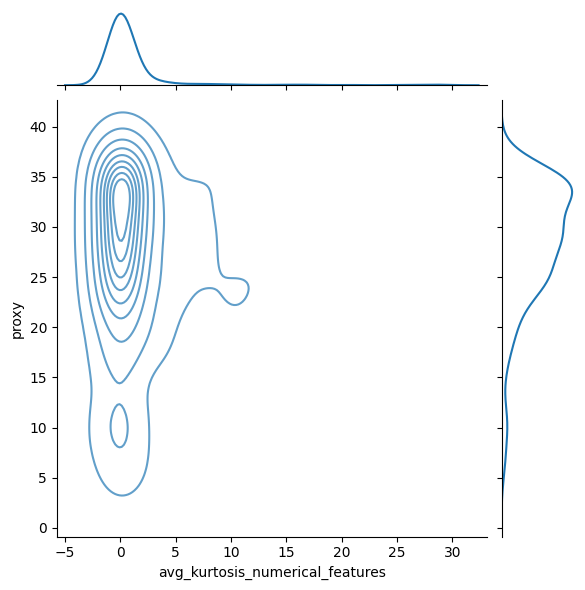

In [53]:
df_plot = df_50_100_agg.filter(pl.col('avg_kurtosis_numerical_features') < 30)
sns.jointplot(x=df_plot['avg_kurtosis_numerical_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')

Text(0, 0.5, 'proxy')

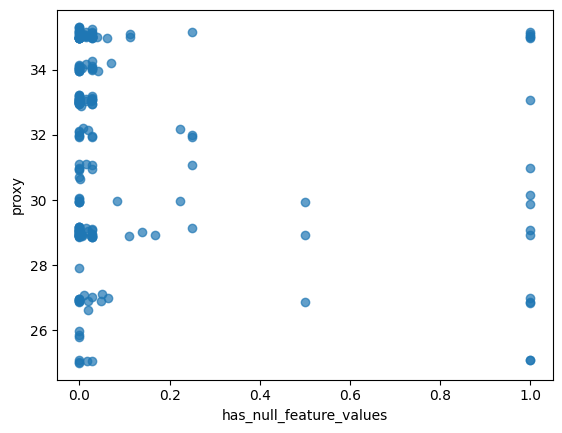

In [54]:
df_plot = df_50_100_agg.filter(pl.col('proxy') > 25)#.filter(pl.col('avg_variance_numerical_features') < 1000)
# sns.jointplot(x=df_plot['avg_ratio_null_values_features'].to_numpy(), y=df_plot['proxy'], alpha=0.7)
plt.scatter(df_plot['has_null_feature_values'].to_numpy(), y=df_plot['proxy'].to_numpy(), alpha=0.7)
plt.xlabel('has_null_feature_values')
plt.ylabel('proxy')

Text(0, 0.5, 'proxy')

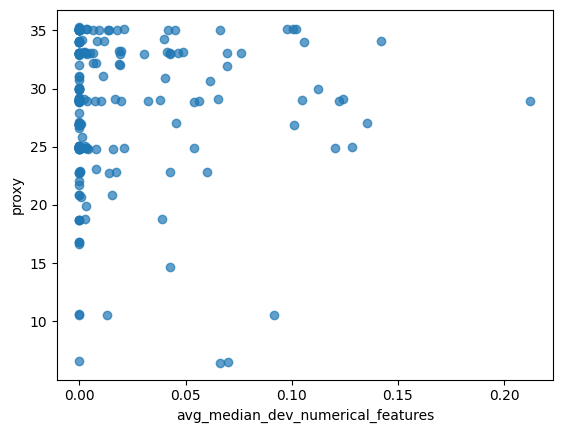

In [55]:
df_plot = df_50_100_agg.filter(pl.col('avg_median_dev_numerical_features') < 0.25)
# sns.jointplot(x=df_plot['avg_median_dev_numerical_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')

plt.scatter(df_plot['avg_median_dev_numerical_features'].to_numpy(), y=df_plot['proxy'].to_numpy(), alpha=0.7)
plt.xlabel('avg_median_dev_numerical_features')
plt.ylabel('proxy')

Text(0, 0.5, 'proxy')

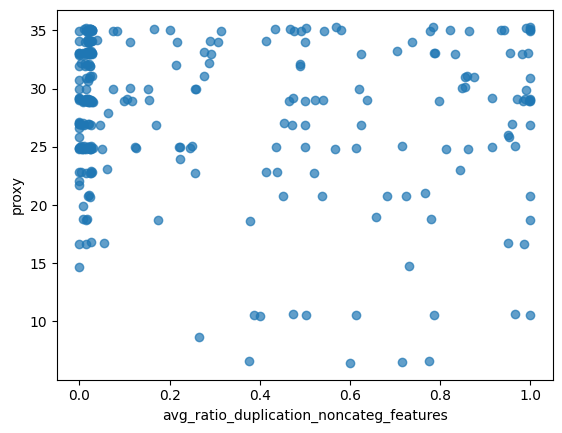

In [56]:
df_plot = df_50_100_agg#.filter(pl.col('avg_variance_numerical_features') < 1000)
# sns.jointplot(x=df_plot['avg_ratio_duplication_noncateg_features'], y=df_plot['proxy'], alpha=0.7)

plt.scatter(df_plot['avg_ratio_duplication_noncateg_features'].to_numpy(), y=df_plot['proxy'].to_numpy(), alpha=0.7)
plt.xlabel('avg_ratio_duplication_noncateg_features')
plt.ylabel('proxy')

`avg_n_outliers_numerical_features`

Text(0, 0.5, 'proxy')

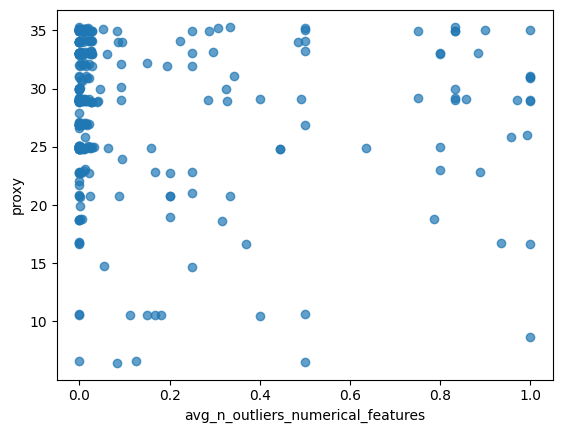

In [57]:
df_plot = df_50_100_agg#.filter(pl.col('avg_variance_numerical_features') < 1000)
# sns.jointplot(x=df_plot['avg_ratio_duplication_noncateg_features'], y=df_plot['proxy'], alpha=0.7)

plt.scatter(df_plot['avg_n_outliers_numerical_features'].to_numpy(), y=df_plot['proxy'].to_numpy(), alpha=0.7)
plt.xlabel('avg_n_outliers_numerical_features')
plt.ylabel('proxy')

`avg_num_pii_entities`

Text(0, 0.5, 'proxy')

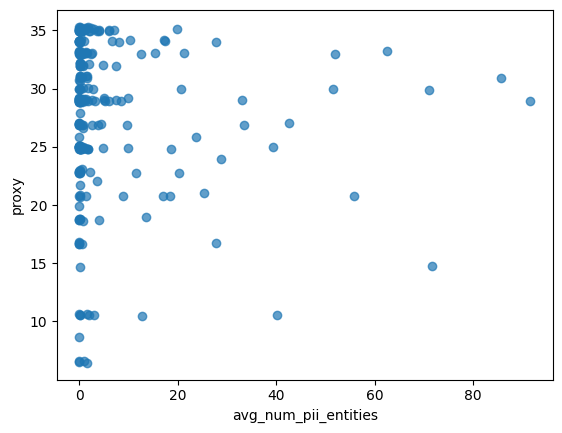

In [58]:
df_plot = df_50_100_agg.filter(pl.col('avg_num_pii_entities') < 100)
# sns.jointplot(x=df_plot['avg_ratio_duplication_noncateg_features'], y=df_plot['proxy'], alpha=0.7)

plt.scatter(df_plot['avg_num_pii_entities'].to_numpy(), y=df_plot['proxy'].to_numpy(), alpha=0.7)
plt.xlabel('avg_num_pii_entities')
plt.ylabel('proxy')

`n_bytes_total`

Text(0, 0.5, 'proxy')

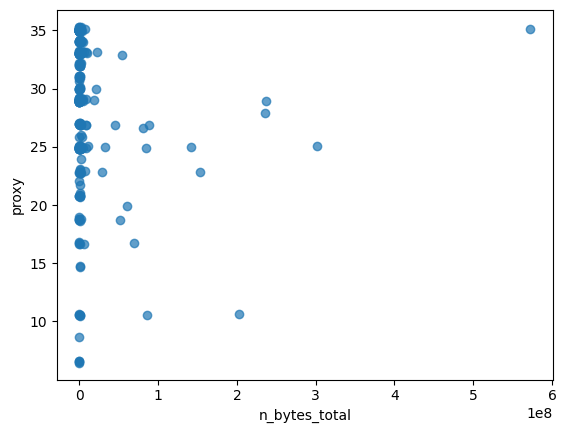

In [59]:
df_plot = df_50_100_agg.filter(pl.col('n_bytes_total') < 10**9)
# sns.jointplot(x=df_plot['avg_ratio_duplication_noncateg_features'], y=df_plot['proxy'], alpha=0.7)

plt.scatter(df_plot['n_bytes_total'].to_numpy(), y=df_plot['proxy'].to_numpy(), alpha=0.7)
plt.xlabel('n_bytes_total')
plt.ylabel('proxy')

`since_last_update`

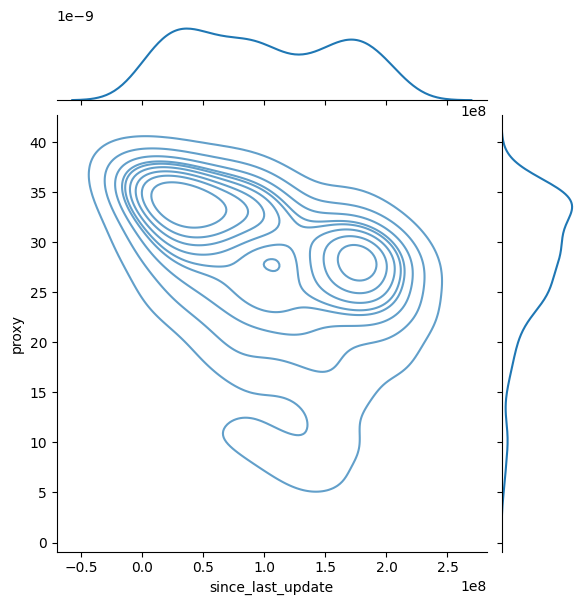

In [60]:
df_plot = df_50_100_agg#.filter(pl.col('n_bytes_total') < 10**9)
sns.jointplot(x=df_plot['since_last_update'], y=df_plot['proxy'], alpha=0.7, kind='kde')

# plt.scatter(df_plot['since_last_update'].to_numpy(), y=df_plot['proxy'].to_numpy(), alpha=0.7)
# plt.xlabel('since_last_update')
# plt.ylabel('proxy')

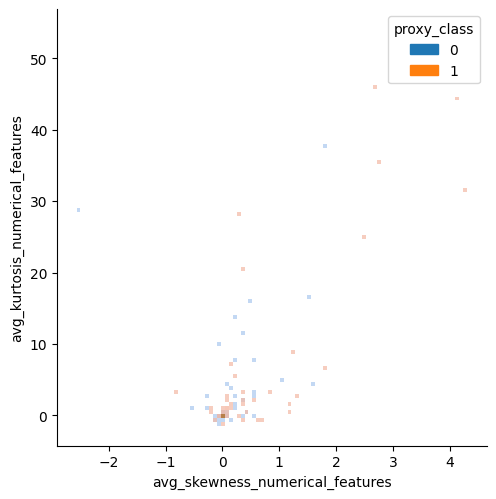

In [61]:
df_plot = df_50_100_agg.filter(
    (pl.col('avg_skewness_numerical_features') < 5)
    & (pl.col('n_float_features') > 0)
    & (pl.col('avg_kurtosis_numerical_features') < 60)
)
g = sns.jointplot(
    data=df_plot,
    y='avg_kurtosis_numerical_features', 
    x='avg_skewness_numerical_features', 
    alpha=0.7, hue='proxy_class', 
    kind='hist',
    joint_kws={'bins': 100}
)
g.ax_marg_x.remove()
g.ax_marg_y.remove()

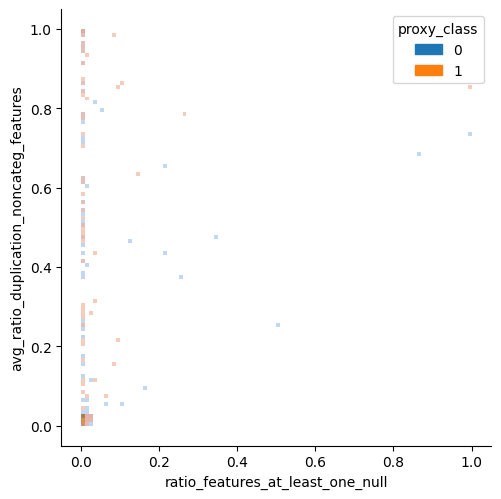

In [62]:
df_plot = df_50_100_agg

# .filter(
#     (pl.col('avg_skewness_numerical_features') < 5)
#     & (pl.col('n_float_features') > 0)
#     & (pl.col('avg_kurtosis_numerical_features') < 60)
# )
g = sns.jointplot(
    data=df_plot,
    y='avg_ratio_duplication_noncateg_features', 
    x='ratio_features_at_least_one_null', 
    alpha=0.7, hue='proxy_class', 
    kind='hist',
    joint_kws={'bins': 100}
)
g.ax_marg_x.remove()
g.ax_marg_y.remove()

In [ ]:
def standardize(x):
    return (x - x.mean())/(x.std())

In [115]:
standardize(np.array([0, 1, 4, 5, 10000]))

array([-0.5006251 , -0.50037504, -0.49962485, -0.49937479,  1.99999979])

In [119]:
standardize(df_plot.filter(pl.col('proxy_class') == 1)['ratio_features_at_least_one_null'].to_numpy())

array([-0.20309699, -0.15405118, -0.20309699, -0.11449064, -0.20309699,
       -0.20309699, -0.11147451, -0.0436981 , -0.20309699,  0.22354939,
       -0.12808575, -0.20309699, -0.20309699, -0.08395035, -0.20309699,
       -0.20309699, -0.11823715, -0.19965835, -0.17546785, -0.19020443,
       -0.20309699, -0.15759552, -0.15132098,  0.11570078, -0.20309699,
        0.03047762, -0.19830298, -0.1719674 , -0.20309699, -0.09990567,
       -0.0436981 , -0.13751574,  0.22863437, -0.20309699, -0.20232876,
       -0.07727814,  1.08261443, -0.10391546, -0.16350365, -0.20309699,
       -0.20309699, -0.20309699, -0.15302664, -0.20309699, -0.20309699,
       -0.20309699,  0.06652453, -0.20309699,  0.03998631, -0.20309699,
       -0.04526755, -0.20003692, -0.10908765, -0.20309699,  0.11552699,
       -0.20309699, -0.20309699, -0.15261824, -0.20309699,  0.04803758,
       -0.20309699, -0.20136514, -0.20309699, -0.20309699,  0.11570078,
       -0.20309699,  0.11566892, -0.20309699,  0.21307139, -0.20

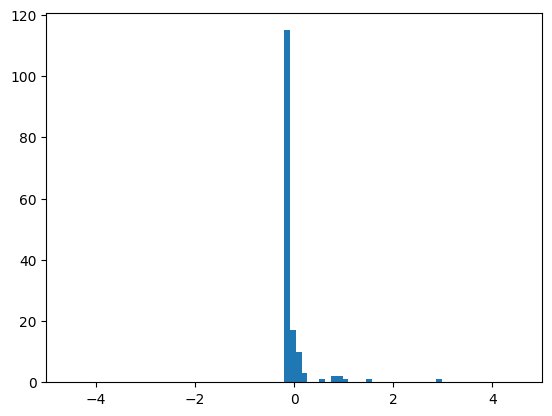

In [120]:
plt.hist(standardize(df_plot.filter(pl.col('proxy_class') == 1)['ratio_features_at_least_one_null'].to_numpy()), bins=100)
plt.xlim((-5, 5))
plt.show()

Text(0, 0.5, 'proxy')

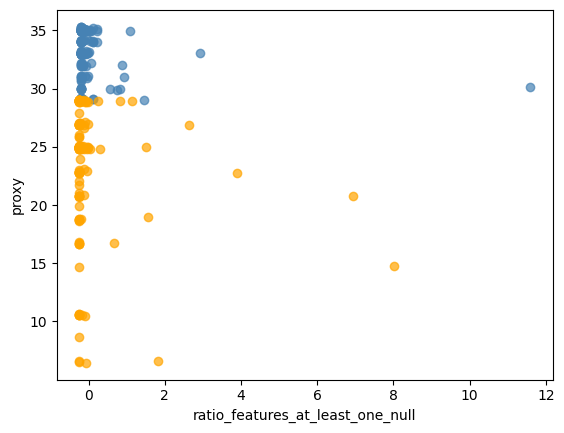

In [123]:
df_plot = df_50_100_agg#.filter(pl.col('n_bytes_total') < 10**9)
# sns.jointplot(x=df_plot['avg_ratio_null_values_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
plt.scatter(
    standardize(df_plot.filter(pl.col('proxy_class') == 1)['ratio_features_at_least_one_null'].to_numpy()), 
    y=df_plot.filter(pl.col('proxy_class') == 1)['proxy'].to_numpy(), 
    alpha=0.7, 
    color='steelblue')
plt.scatter(
    standardize(df_plot.filter(pl.col('proxy_class') == 0)['ratio_features_at_least_one_null'].to_numpy()), 
    y=df_plot.filter(pl.col('proxy_class') == 0)['proxy'].to_numpy(), 
    alpha=0.7, 
    color='orange')

plt.xlabel('ratio_features_at_least_one_null')
plt.ylabel('proxy')


In [125]:
df_50_100_agg.filter(pl.col('ratio_features_at_least_one_null') > 1).filter(pl.col('proxy_class') == 1)

ref_no_slash,n_int_features,n_float_features,n_string_features,n_datetime_features,n_unknown_features,n_categorical_features,n_noncateg_features,is_datetime_consistent,n_ordered_features,has_duplicated_rows,has_null_rows,has_null_feature_values,n_features,avg_n_features,n_rows,avg_n_rows,n_rows_times_features,avg_n_rows_times_features,avg_ratio_duplication_noncateg_features,avg_ratio_duplication_categ_features,ratio_features_at_least_one_null,avg_ratio_null_values_features,avg_variance_numerical_features,avg_skewness_numerical_features,avg_kurtosis_numerical_features,avg_median_dev_numerical_features,avg_n_outliers_numerical_features,avg_unalikeability_categ_features,avg_margin_error_numerical_features,avg_gini_impurity_categ_features,avg_num_pii_entities,n_bytes_total,since_last_update,profiler_sample_size,proxy,proxy_class
str,i64,i64,i64,i64,i64,i64,i64,f64,i64,f64,f64,f64,i64,f64,i64,f64,i64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,i64,f64,i64,f64,i64


Text(0, 0.5, 'proxy')

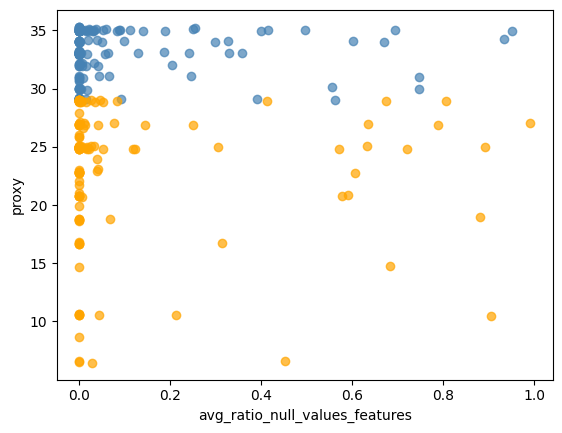

In [64]:
df_plot = df_50_100_agg#.filter(pl.col('n_bytes_total') < 10**9)
# sns.jointplot(x=df_plot['avg_ratio_null_values_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
plt.scatter(
    df_plot.filter(pl.col('proxy_class') == 1)['avg_ratio_null_values_features'].to_numpy(), 
     y=df_plot.filter(pl.col('proxy_class') == 1)['proxy'].to_numpy(), 
    alpha=0.7, 
    color='steelblue')
plt.scatter(
    df_plot.filter(pl.col('proxy_class') == 0)['avg_ratio_null_values_features'].to_numpy(), 
    y=df_plot.filter(pl.col('proxy_class') == 0)['proxy'].to_numpy(), 
    alpha=0.7, 
    color='orange')

plt.xlabel('avg_ratio_null_values_features')
plt.ylabel('proxy')

In [76]:
df_50_100_agg.filter(
    pl.col('avg_ratio_null_values_features') > 0.2
).select(
    (pl.col('proxy_class') == 1).count().alias('proxy_class_1'),
    (pl.col('proxy_class') == 0).count().alias('proxy_class_0'),
)


proxy_class_1,proxy_class_0
u32,u32
43,43


Text(0, 0.5, 'proxy')

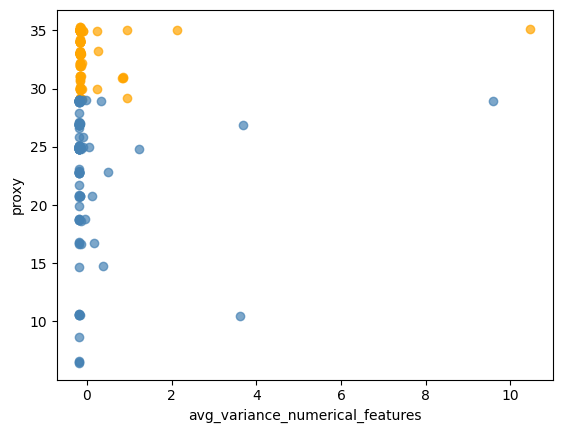

In [77]:
df_plot = df_50_100_agg.filter(
    (pl.col('avg_variance_numerical_features') < 100000)
    & ((pl.col('n_int_features') + pl.col('n_float_features')) > 0)
)
# sns.jointplot(x=df_plot['avg_ratio_null_values_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
plt.scatter(
    standardize(df_plot.filter(pl.col('proxy_class') == 1)['avg_variance_numerical_features'].to_numpy()), 
    y=df_plot.filter(pl.col('proxy_class') == 1)['proxy'].to_numpy(), 
    alpha=0.7, 
    color='orange')
plt.scatter(
    standardize(df_plot.filter(pl.col('proxy_class') == 0)['avg_variance_numerical_features'].to_numpy()), 
    y=df_plot.filter(pl.col('proxy_class') == 0)['proxy'].to_numpy(), 
    alpha=0.7, 
    color='steelblue')

plt.xlabel('avg_variance_numerical_features')
plt.ylabel('proxy')

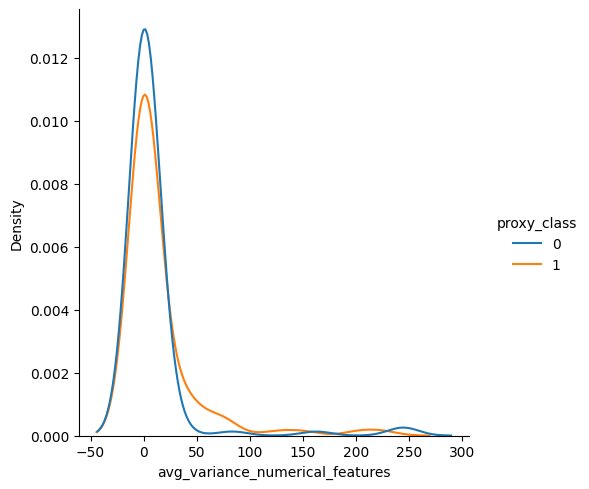

In [66]:
sns.displot(
    df_50_100_agg.filter(
        (pl.col('avg_variance_numerical_features') < 270)
        & ((pl.col('n_int_features') + pl.col('n_float_features')) > 0)
    ),
    x="avg_variance_numerical_features", 
    hue="proxy_class", 
    kind="kde")


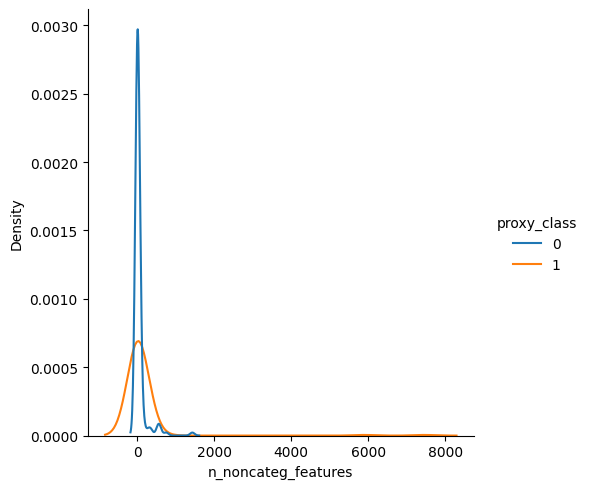

In [67]:
sns.displot(
    df_50_100_agg,
    x="n_noncateg_features", 
    hue="proxy_class", 
    kind="kde")


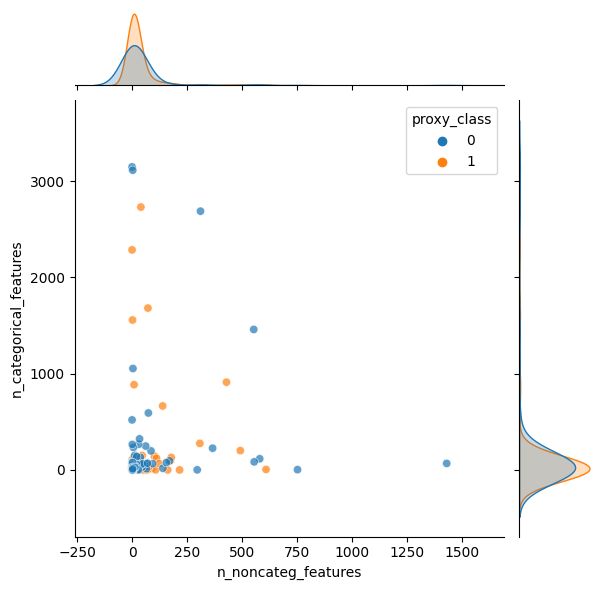

In [79]:
df_plot = df_50_100_agg.filter(
    (pl.col('n_categorical_features') < 4000)
    & (pl.col('n_noncateg_features') < 4000)
)
# sns.jointplot(x=df_plot['avg_ratio_null_values_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
sns.jointplot(
    data=df_plot,
    x='n_noncateg_features', 
    y='n_categorical_features', 
    alpha=0.7,
    hue='proxy_class',
    marker='o')

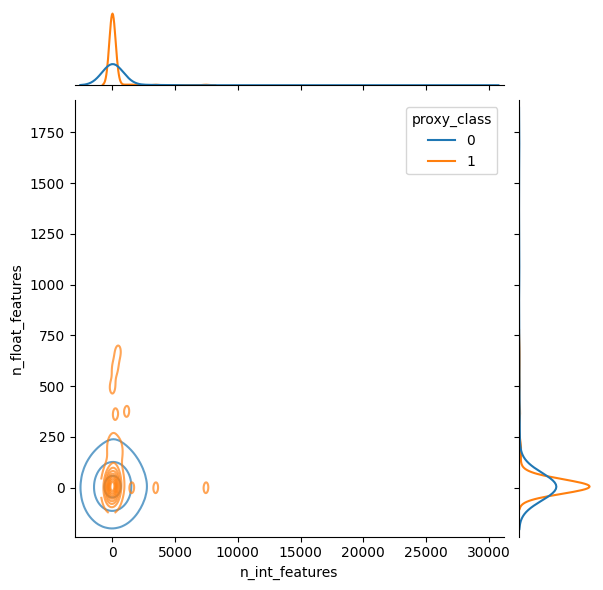

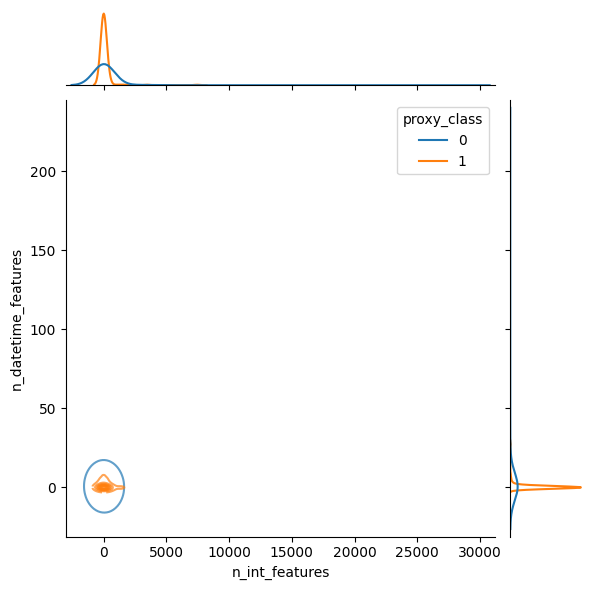

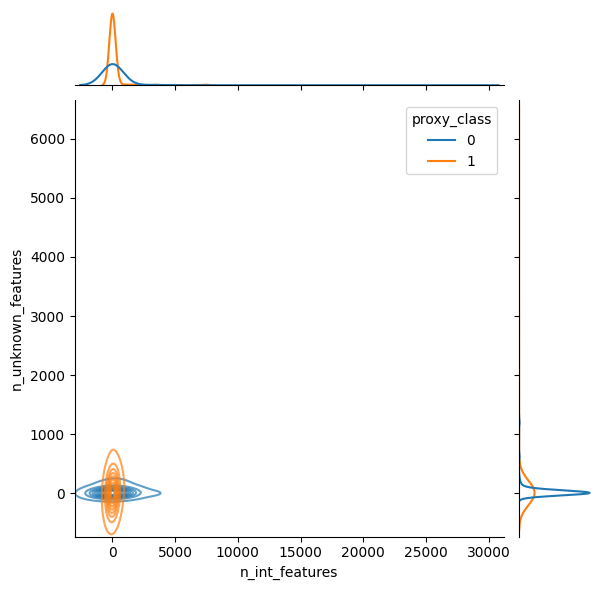

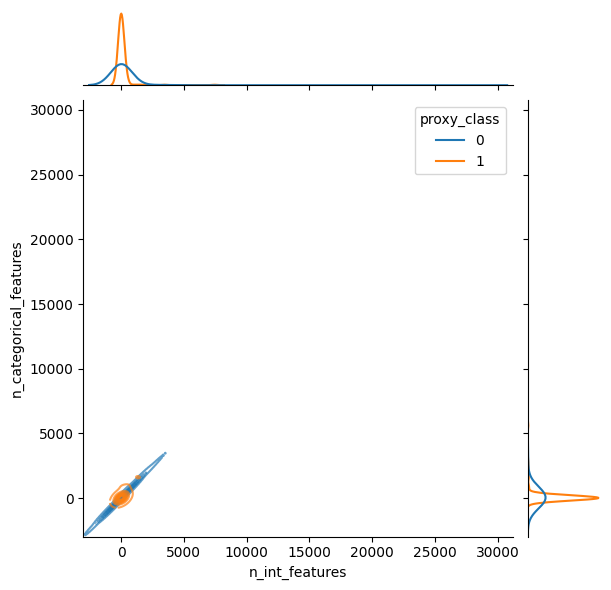

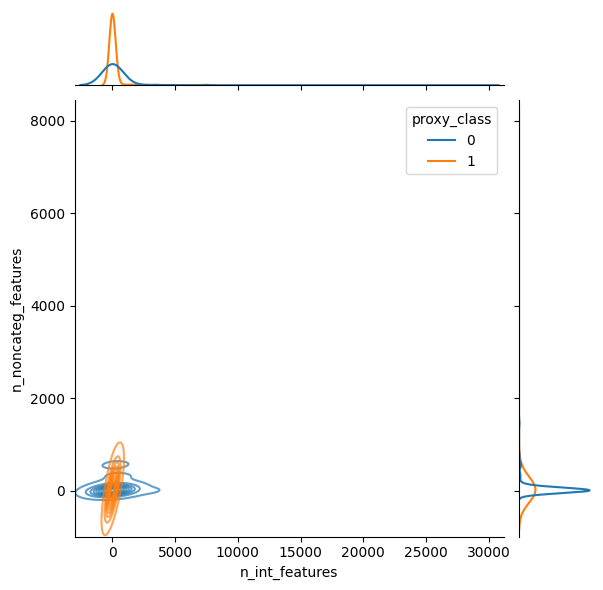

...

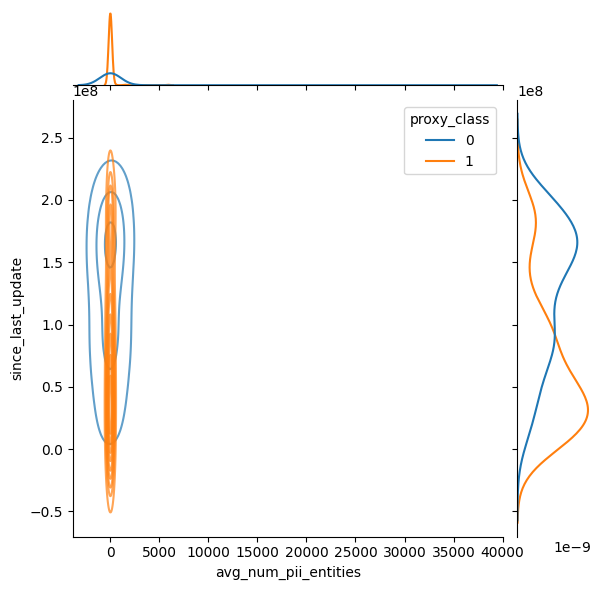

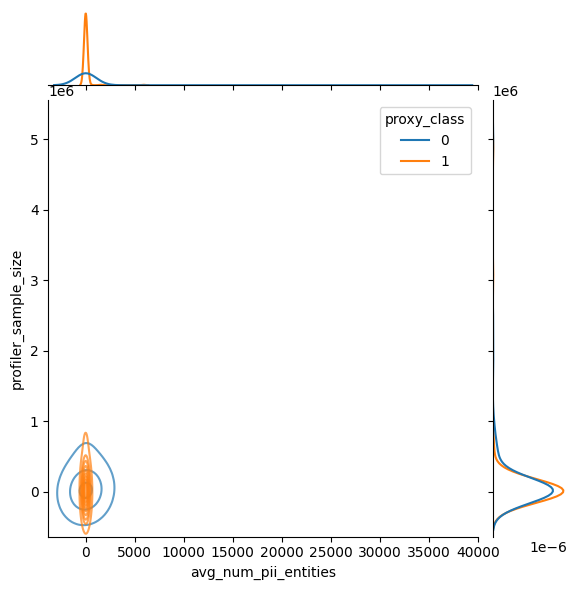

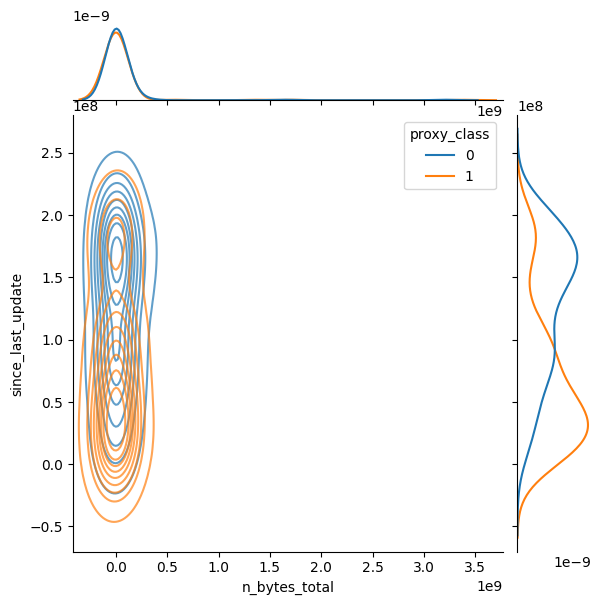

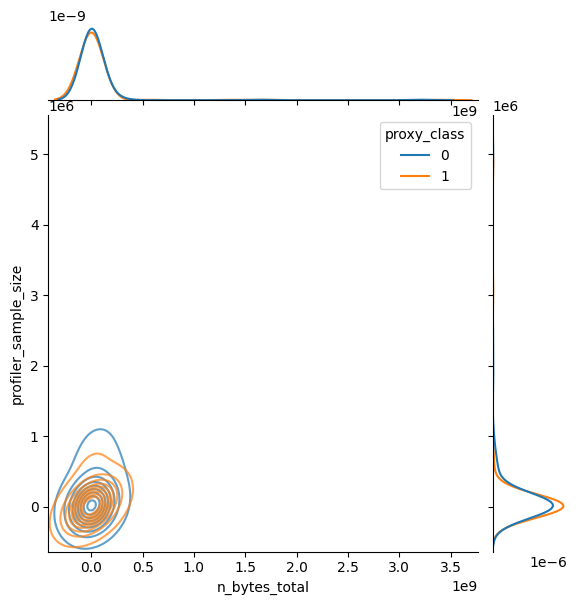

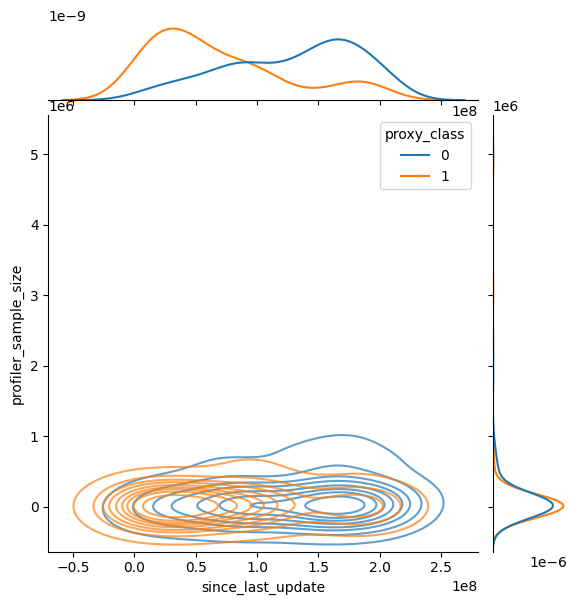

In [69]:
cols = [
    'n_int_features',
    'n_float_features',
    'n_datetime_features',
    'n_unknown_features',
    'n_categorical_features',
    'n_noncateg_features',
    'is_datetime_consistent',
    'n_ordered_features',
    'has_duplicated_rows',
    'has_null_rows',
    'has_null_feature_values',
    'n_features',
    'avg_n_features',
    'n_rows',
    'avg_n_rows',
    'n_rows_times_features',
    'avg_n_rows_times_features',
    'avg_ratio_duplication_noncateg_features',
    'avg_ratio_duplication_categ_features',
    'ratio_features_at_least_one_null',
    'avg_ratio_null_values_features',
    'avg_variance_numerical_features',
    'avg_skewness_numerical_features',
    'avg_kurtosis_numerical_features',
    'avg_median_dev_numerical_features',
    'avg_n_outliers_numerical_features',
    'avg_unalikeability_categ_features',
    'avg_margin_error_numerical_features',
    'avg_gini_impurity_categ_features',
    'avg_num_pii_entities',
    'n_bytes_total',
    'since_last_update',
    'profiler_sample_size',
]
for i in range(0, len(cols) - 1):
    for j in range(i + 1, len(cols)):
        df_plot = df_50_100_agg
        sns.jointplot(
            data=df_plot,
            x=cols[i], 
            y=cols[j], 
            alpha=0.7,
            hue='proxy_class',
            kind='kde')
        plt.show()

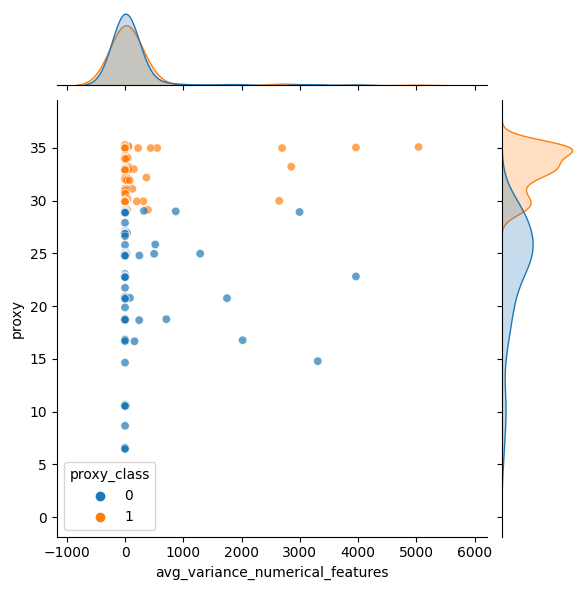

In [445]:
df_plot = df_50_100_agg.filter(
    (pl.col('avg_variance_numerical_features') < 6000)
    & ((pl.col('n_int_features') + pl.col('n_float_features')) > 0)
)
# sns.jointplot(x=df_plot['avg_ratio_null_values_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
sns.jointplot(
    data=df_plot,
    x='avg_variance_numerical_features', 
    y='proxy', 
    alpha=0.7,
    hue='proxy_class',
    marker='o')

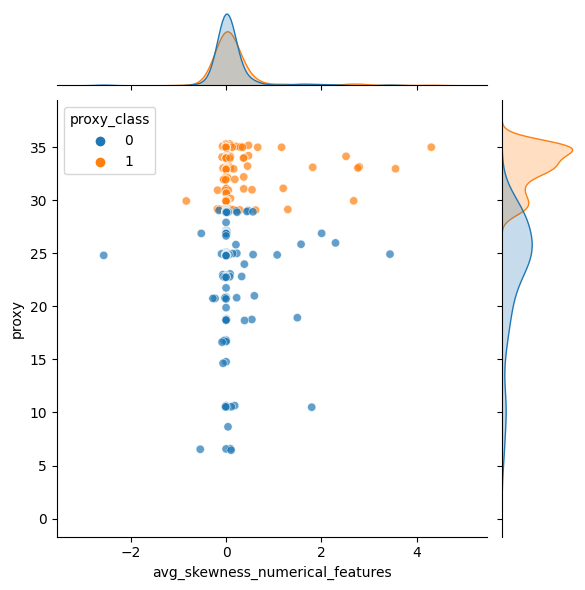

In [420]:
df_plot = df_50_100_agg.filter(
    (pl.col('avg_skewness_numerical_features') < 12.5)
    # & (pl.col('avg_skewness_numerical_features') < 0.5)
    & ((pl.col('n_int_features') + pl.col('n_float_features')) > 0)
)
# sns.jointplot(x=df_plot['avg_ratio_null_values_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
sns.jointplot(
    data=df_plot,
    x='avg_skewness_numerical_features', 
    y='proxy', 
    alpha=0.7,
    hue='proxy_class',
    marker='o')

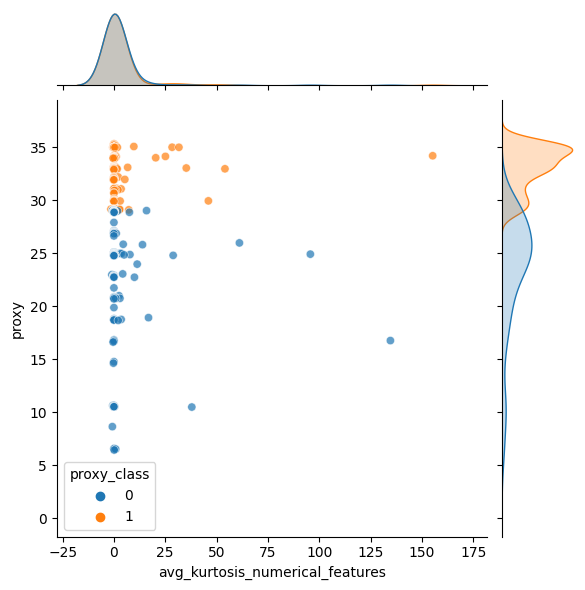

In [423]:
df_plot = df_50_100_agg.filter(
    (pl.col('avg_kurtosis_numerical_features') < 200)
    # & (pl.col('avg_skewness_numerical_features') < 0.5)
    & ((pl.col('n_int_features') + pl.col('n_float_features')) > 0)
)
# sns.jointplot(x=df_plot['avg_ratio_null_values_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
sns.jointplot(
    data=df_plot,
    x='avg_kurtosis_numerical_features', 
    y='proxy', 
    alpha=0.7,
    hue='proxy_class',
    marker='o')

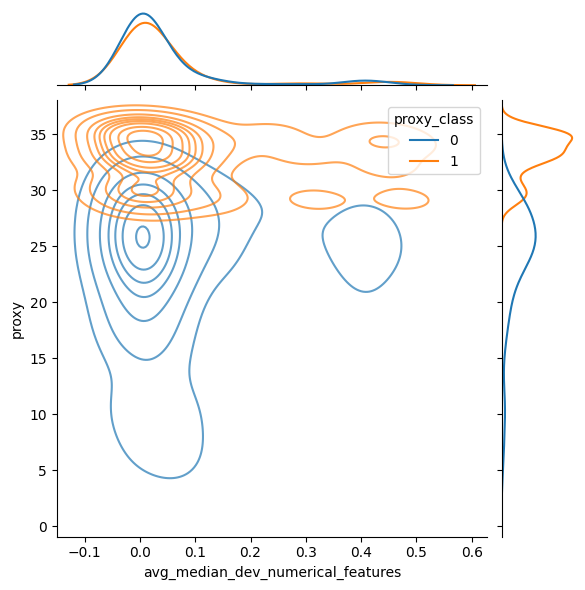

In [427]:
df_plot = df_50_100_agg.filter(
    (pl.col('avg_median_dev_numerical_features') < 0.5)
    # & (pl.col('avg_skewness_numerical_features') < 0.5)
    & ((pl.col('n_int_features') + pl.col('n_float_features')) > 0)
)
# sns.jointplot(x=df_plot['avg_ratio_null_values_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
sns.jointplot(
    data=df_plot,
    x='avg_median_dev_numerical_features', 
    y='proxy', 
    alpha=0.7,
    hue='proxy_class',
    kind='kde',
    #marker='o'
)

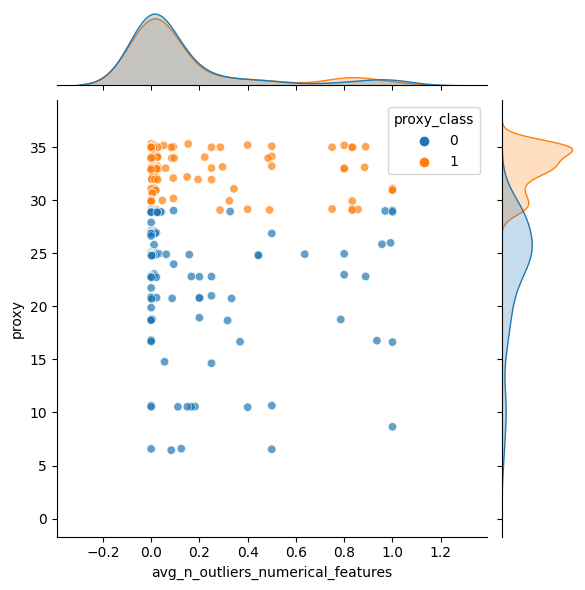

In [429]:
df_plot = df_50_100_agg.filter(
    #(pl.col('avg_median_dev_numerical_features') < 0.5)
    # & (pl.col('avg_skewness_numerical_features') < 0.5)
    ((pl.col('n_int_features') + pl.col('n_float_features')) > 0)
)
# sns.jointplot(x=df_plot['avg_ratio_null_values_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
sns.jointplot(
    data=df_plot,
    x='avg_n_outliers_numerical_features', 
    y='proxy', 
    alpha=0.7,
    hue='proxy_class',
    # kind='kde',
    marker='o'
)

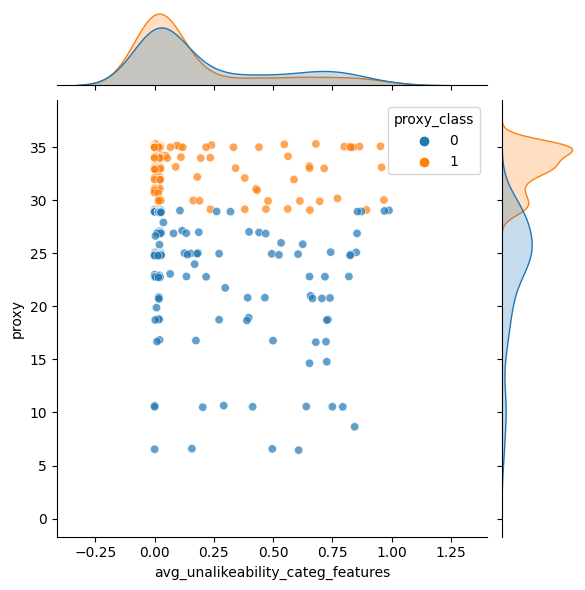

In [430]:
df_plot = df_50_100_agg.filter(
    #(pl.col('avg_median_dev_numerical_features') < 0.5)
    # & (pl.col('avg_skewness_numerical_features') < 0.5)
    ((pl.col('n_int_features') + pl.col('n_float_features')) > 0)
)
# sns.jointplot(x=df_plot['avg_ratio_null_values_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
sns.jointplot(
    data=df_plot,
    x='avg_unalikeability_categ_features', 
    y='proxy', 
    alpha=0.7,
    hue='proxy_class',
    # kind='kde',
    marker='o'
)

Text(0, 0.5, 'proxy')

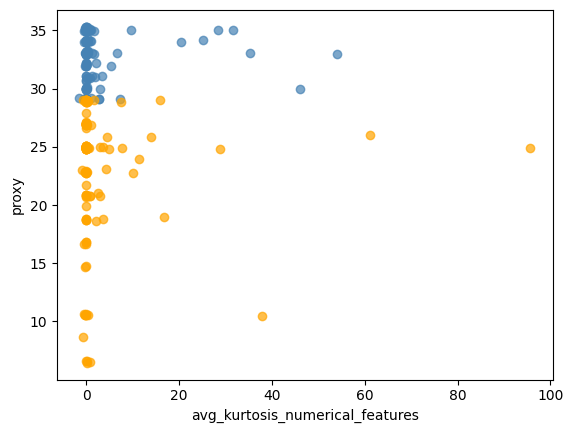

In [442]:
df_plot = df_50_100_agg.filter(
    (pl.col('avg_kurtosis_numerical_features') < 100)
    & ((pl.col('n_int_features') + pl.col('n_float_features')) > 0)
)
# sns.jointplot(x=df_plot['avg_ratio_null_values_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
plt.scatter(
    df_plot.filter(pl.col('proxy_class') == 1)['avg_kurtosis_numerical_features'].to_numpy(), 
     y=df_plot.filter(pl.col('proxy_class') == 1)['proxy'].to_numpy(), 
    alpha=0.7, 
    color='steelblue')
plt.scatter(
    df_plot.filter(pl.col('proxy_class') == 0)['avg_kurtosis_numerical_features'].to_numpy(), 
    y=df_plot.filter(pl.col('proxy_class') == 0)['proxy'].to_numpy(), 
    alpha=0.7, 
    color='orange')

plt.xlabel('avg_kurtosis_numerical_features')
plt.ylabel('proxy')

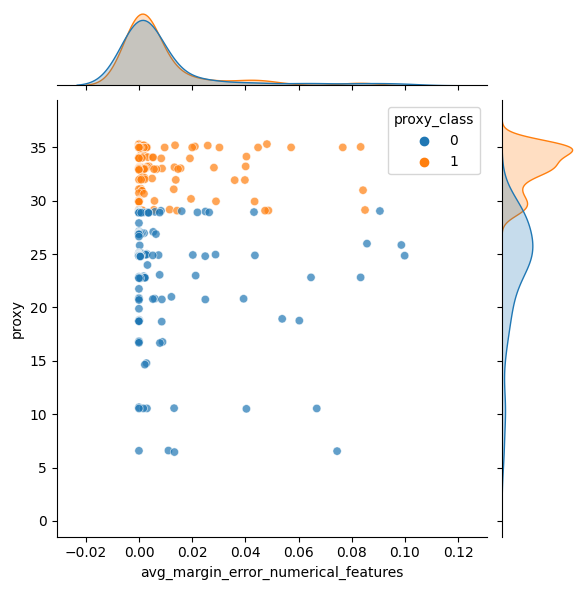

In [443]:
df_plot = df_50_100_agg.filter(
    (pl.col('avg_margin_error_numerical_features') < 0.1)
    # & (pl.col('avg_skewness_numerical_features') < 0.5)
    & ((pl.col('n_int_features') + pl.col('n_float_features')) > 0)
)
# sns.jointplot(x=df_plot['avg_ratio_null_values_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
sns.jointplot(
    data=df_plot,
    x='avg_margin_error_numerical_features', 
    y='proxy', 
    alpha=0.7,
    hue='proxy_class',
    # kind='kde',
    marker='o'
)

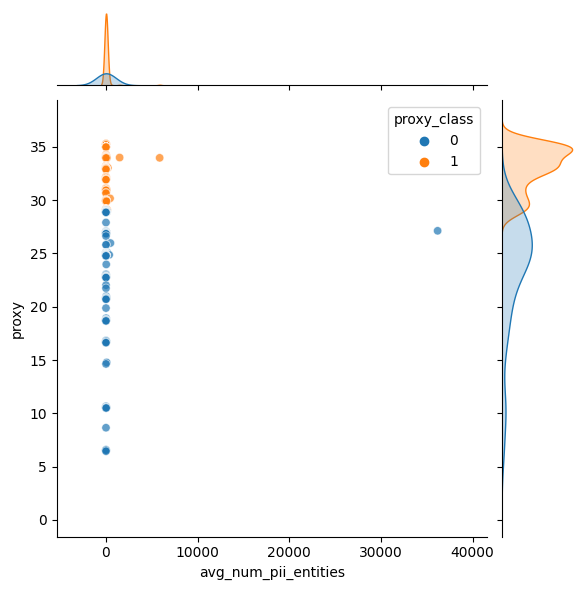

In [437]:
df_plot = df_50_100_agg#.filter(
    # (pl.col('avg_margin_error_numerical_features') < 0.4)
    # & (pl.col('avg_skewness_numerical_features') < 0.5)
    # ((pl.col('n_int_features') + pl.col('n_float_features')) > 0)
#)
# sns.jointplot(x=df_plot['avg_ratio_null_values_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
sns.jointplot(
    data=df_plot,
    x='avg_num_pii_entities', 
    y='proxy', 
    alpha=0.7,
    hue='proxy_class',
    # kind='kde',
    marker='o'
)

In [ ]:
cols = df_50_100_agg.columns
for i in range(cols - 1):
    for j in range(i, cols):
        quantiles = np.quantiles
        df_plot = df_50_100_agg#.filter(
    # (pl.col('avg_margin_error_numerical_features') < 0.4)
    # & (pl.col('avg_skewness_numerical_features') < 0.5)
    # ((pl.col('n_int_features') + pl.col('n_float_features')) > 0)
#)
# sns.jointplot(x=df_plot['avg_ratio_null_values_features'], y=df_plot['proxy'], alpha=0.7, kind='kde')
sns.jointplot(
    data=df_plot,
    x='avg_num_pii_entities', 
    y='proxy', 
    alpha=0.7,
    hue='proxy_class',
    # kind='kde',
    marker='o'
)
        

In [438]:
df_50_100_agg.columns

['ref_no_slash',
 'n_int_features',
 'n_float_features',
 'n_string_features',
 'n_datetime_features',
 'n_unknown_features',
 'n_categorical_features',
 'n_noncateg_features',
 'is_datetime_consistent',
 'n_ordered_features',
 'has_duplicated_rows',
 'has_null_rows',
 'has_null_feature_values',
 'n_features',
 'avg_n_features',
 'n_rows',
 'avg_n_rows',
 'n_rows_times_features',
 'avg_n_rows_times_features',
 'avg_ratio_duplication_noncateg_features',
 'avg_ratio_duplication_categ_features',
 'ratio_features_at_least_one_null',
 'avg_ratio_null_values_features',
 'avg_variance_numerical_features',
 'avg_skewness_numerical_features',
 'avg_kurtosis_numerical_features',
 'avg_median_dev_numerical_features',
 'avg_n_outliers_numerical_features',
 'avg_unalikeability_categ_features',
 'avg_margin_error_numerical_features',
 'avg_gini_impurity_categ_features',
 'avg_num_pii_entities',
 'n_bytes_total',
 'since_last_update',
 'profiler_sample_size',
 'proxy',
 'proxy_class']

Perform **PCA**

In [400]:
df_50_100_agg.filter(pl.col('proxy_class') == 1).shape[0] - df_50_100_agg.filter(pl.col('proxy_class') == 0).shape[0]

2

In [125]:
pca = PCA(n_components=2)

pcs = pca.fit_transform(df_50_100_enc_agg.drop('ref_no_slash').drop('proxy').to_numpy())


ValueError: Input X contains NaN.
PCA does not accept missing values encoded as NaN natively. For supervised learning, you might want to consider sklearn.ensemble.HistGradientBoostingClassifier and Regressor which accept missing values encoded as NaNs natively. Alternatively, it is possible to preprocess the data, for instance by using an imputer transformer in a pipeline or drop samples with missing values. See https://scikit-learn.org/stable/modules/impute.html You can find a list of all estimators that handle NaN values at the following page: https://scikit-learn.org/stable/modules/impute.html#estimators-that-handle-nan-values

In [127]:
for col in df_50_100_enc_agg.drop('ref_no_slash').columns:
    print(df_50_100_enc_agg[col].is_nan().sum())

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


In [128]:
df_50_100_enc_agg.columns[21:24]

['avg_ratio_null_values_features',
 'avg_variance_numerical_features',
 'avg_skewness_numerical_features']

In [275]:
pcs.shape

(3209, 2)

In [282]:
print(pca.explained_variance_ratio_)

print(pca.singular_values_)

[9.99994835e-01 5.03558117e-06]
[1.03469656e+13 2.32187549e+10]


In [ ]:
proxy_median = df_50_100['proxy'].median()
df_500_100_with_above_median = df_50_100.with_columns(
    pl.col('proxy').apply(lambda proxy: 1 if proxy >= proxy_median else 0).alias('proxy_above_median')
)
df_500_100_with_above_median

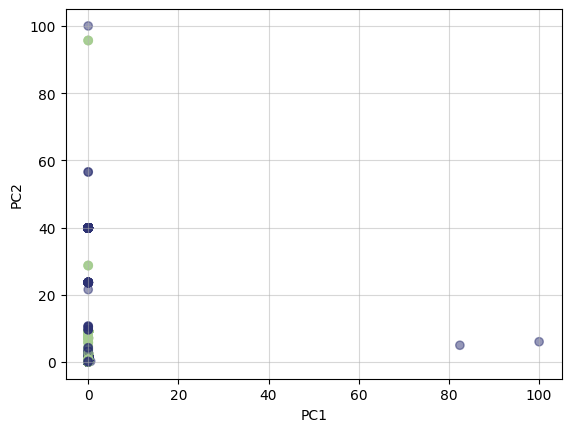

In [280]:
plt.scatter(normalize(pcs[:, 0]), normalize(pcs[:, 1]), c=df_500_100_with_above_median['proxy_above_median'], cmap='crest', alpha=0.5)
plt.xlabel('PC1')
plt.ylabel('PC2')

plt.grid(alpha=0.5)

plt.show()

In [187]:
pc_df

,0,1
0,-1.506099e+112,-4.583410e+09
1,-1.506099e+112,-4.583410e+09
2,-1.506099e+112,-4.583411e+09
3,-1.506099e+112,-4.583411e+09
4,-1.506099e+112,-4.583411e+09
...,...,...
3204,-1.506099e+112,-4.583411e+09
3205,-1.506099e+112,-4.583414e+09
3206,-1.506099e+112,-4.583414e+09
3207,-1.506099e+112,-4.583411e+09


In [237]:
for col in df_50_100_enc.columns:
    print(df_50_100_enc[col].is_nan().sum())

0
0
3209
0
0
0
0
0
0
0
0
0
0
0
0
3209
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
